# Face Generation

In this project, you'll define and train a Generative Adverserial network of your own creation on a dataset of faces. Your goal is to get a generator network to generate *new* images of faces that look as realistic as possible!

The project will be broken down into a series of tasks from **defining new architectures training adversarial networks**. At the end of the notebook, you'll be able to visualize the results of your trained Generator to see how it performs; your generated samples should look like fairly realistic faces with small amounts of noise.

### Get the Data

You'll be using the [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) to train your adversarial networks.

This dataset has higher resolution images than datasets you have previously worked with (like MNIST or SVHN) you've been working with, and so, you should prepare to define deeper networks and train them for a longer time to get good results. It is suggested that you utilize a GPU for training.

### Pre-processed Data

Since the project's main focus is on building the GANs, we've done *some* of the pre-processing for you. Each of the CelebA images has been cropped to remove parts of the image that don't include a face, then resized down to 64x64x3 NumPy images. Some sample data is show below.

<img src='assets/processed_face_data.png' width=60% />

> If you are working locally, you can download this data [by clicking here](https://s3.amazonaws.com/video.udacity-data.com/topher/2018/November/5be7eb6f_processed-celeba-small/processed-celeba-small.zip)

This is a zip file that you'll need to extract in the home directory of this notebook for further loading and processing. After extracting the data, you should be left with a directory of data `processed-celeba-small/`.

In [30]:
# Pre-requisite: Select PyTorch 2.0.0 kernel

In [31]:
# Rubric: https://review.udacity.com/#!/rubrics/4801/view


In [32]:
# run this once to unzip the file
# !unzip processed-celeba-small.zip

In [33]:
from glob import glob
from typing import Tuple, Callable, Dict

import matplotlib.pyplot as plt
import numpy as np
import torch
from PIL import Image
from torch.utils.data import DataLoader, Dataset
from torchvision.transforms import Compose, ToTensor
from torchvision import datasets
import torchvision
import os
import multiprocessing
from tqdm import tqdm

import tests

device = 'cuda'


In [34]:
data_dir = 'processed-celeba-small/celeba'

## Data pipeline

The [CelebA](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations. Since you're going to be generating faces, you won't need the annotations, you'll only need the images. Note that these are color images with [3 color channels (RGB)](https://en.wikipedia.org/wiki/Channel_(digital_image)#RGB_Images) each.

### Pre-process and Load the Data

Since the project's main focus is on building the GANs, we've done *some* of the pre-processing for you. Each of the CelebA images has been cropped to remove parts of the image that don't include a face, then resized down to 64x64x3 NumPy images. This *pre-processed* dataset is a smaller subset of the very large CelebA dataset and contains roughly 30,000 images. 

Your first task consists in building the dataloader. To do so, you need to do the following:
* implement the get_transforms function
* create a custom Dataset class that reads the CelebA data

### Exercise: implement the get_transforms function

The `get_transforms` function should output a [`torchvision.transforms.Compose`](https://pytorch.org/vision/stable/generated/torchvision.transforms.Compose.html#torchvision.transforms.Compose) of different transformations. You have two constraints:
* the function takes a tuple of size as input and should **resize the images** to the input size
* the output images should have values **ranging from -1 to 1**

In [35]:
def get_transforms(size: Tuple[int, int]) -> Callable:
    """ Transforms to apply to the image."""
    # TODO: edit this function by appening transforms to the below list
        
    transforms = [
        torchvision.transforms.Resize(size),   
        torchvision.transforms.ToTensor(),
        torchvision.transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
    ]        
    
    return Compose(transforms)

### Exercise: implement the DatasetDirectory class


The `DatasetDirectory` class is a torch Dataset that reads from the above data directory. The `__getitem__` method should output a transformed tensor and the `__len__` method should output the number of files in our dataset. You can look at [this custom dataset](https://pytorch.org/tutorials/beginner/basics/data_tutorial.html#creating-a-custom-dataset-for-your-files) for ideas. 

In [36]:
class DatasetDirectory(Dataset):
    """
    A custom dataset class that loads images from folder.
    args:
    - directory: location of the images
    - transform: transform function to apply to the images
    - extension: file format
    """
    def __init__(self, 
                 directory: str, 
                 transforms: Callable = None, 
                 extension: str = '.jpg'):
        # TODO: implement the init method
        
        self.directory = directory
        self.transforms = transforms
        self.extension = extension
        self.filenames = [f for f in os.listdir(directory) if f.endswith(extension)]


    def __len__(self) -> int:
        """ returns the number of items in the dataset """
        # TODO: return the number of elements in the dataset
        return len(self.filenames)

    def __getitem__(self, index: int) -> torch.Tensor:
        """ load an image and apply transformation """
        # TODO: return the index-element of the dataset
        
        filename = self.filenames[index]
        filepath = os.path.join(self.directory, filename)
        image = Image.open(filepath)
        
        if self.transforms:
            image = self.transforms(image)
        
        return image        

In [37]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
# run this cell to verify your dataset implementation
dataset = DatasetDirectory(data_dir, get_transforms((64, 64)))
tests.check_dataset_outputs(dataset)

Congrats, your dataset implementation passed all the tests


The functions below will help you visualize images from the dataset.

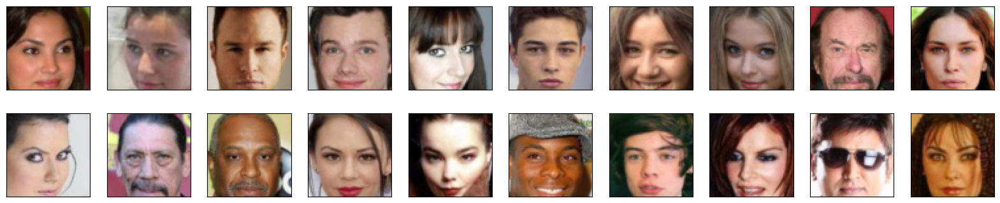

In [38]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""

def denormalize(images):
    """Transform images from [-1.0, 1.0] to [0, 255] and cast them to uint8."""
    return ((images + 1.) / 2. * 255).astype(np.uint8)

# plot the images in the batch, along with the corresponding labels
fig = plt.figure(figsize=(20, 4))
plot_size=20
for idx in np.arange(plot_size):
    ax = fig.add_subplot(2, int(plot_size/2), idx+1, xticks=[], yticks=[])
    img = dataset[idx].numpy()
    img = np.transpose(img, (1, 2, 0))
    img = denormalize(img)
    ax.imshow(img)

## Model implementation

As you know, a GAN is comprised of two adversarial networks, a discriminator and a generator. Now that we have a working data pipeline, we need to implement the discriminator and the generator. 

Feel free to implement any additional class or function.

### Exercise: Create the discriminator

The discriminator's job is to score real and fake images. You have two constraints here:
* the discriminator takes as input a **batch of 64x64x3 images**
* the output should be a single value (=score)

Feel free to get inspiration from the different architectures we talked about in the course, such as DCGAN, WGAN-GP or DRAGAN.

#### Some tips
* To scale down from the input image, you can either use `Conv2d` layers with the correct hyperparameters or Pooling layers.
* If you plan on using gradient penalty, do not use Batch Normalization layers in the discriminator.

In [39]:
from torch.nn import Module
import torch.nn as nn
import torch.nn.functional as F

In [40]:
def conv(in_channels, out_channels, kernel_size, stride=2, padding=1, batch_norm=True):
    """Creates a convolutional layer, with optional batch normalization.
    """
    layers = []
    conv_layer = nn.Conv2d(in_channels=in_channels, out_channels=out_channels, 
                           kernel_size=kernel_size, stride=stride, padding=padding, bias=False)
    
    layers.append(conv_layer)

    if batch_norm:
        layers.append(nn.BatchNorm2d(out_channels))
    return nn.Sequential(*layers)

class Discriminator(Module):        
    def __init__(self, conv_dim=64):
        super(Discriminator, self).__init__()
        # TODO: instantiate the different layers
        
        self.conv1 = conv(3, conv_dim, 4, batch_norm=False) # x, y = 64, depth 64  (64, 64, 3) -> (32, 32, 64)
        self.conv2 = conv(conv_dim, conv_dim*2, 4) # (32, 32, 128)                 (32, 32, 64) -> (16, 16, 128)
        self.conv3 = conv(conv_dim*2, conv_dim*4, 4) # (16, 16, 256)               (16, 16, 128) -> (8, 8, 256)
        self.conv4 = conv(conv_dim*4, conv_dim*8, 4) # (8, 8, 512)                 (8, 8, 256) -> (4, 4, 512)
        
        self.conv5 = conv(conv_dim*8, 1, 4, stride=1, padding=0, batch_norm=False) # (4, 4, 512) -> (1, 1, 1)    
        
        # According to the paper: "In the LeakyReLU, the slope of the leak was set to 0.2 in all models"        
        self.activation = nn.LeakyReLU(0.2)
        
        
    def forward(self, x: torch.Tensor):
        out = self.activation(self.conv1(x))
        out = self.activation(self.conv2(out))
        out = self.activation(self.conv3(out))
        out = self.activation(self.conv4(out))
        out = self.conv5(out)
        
        return out

In [41]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
# run this cell to check your discriminator implementation
discriminator = Discriminator()

print(discriminator)
tests.check_discriminator(discriminator)

Discriminator(
  (conv1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  )
  (conv2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv3): Sequential(
    (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv4): Sequential(
    (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv5): Sequential(
    (0): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
  )
  (activation): LeakyReLU(negative_slope=0.2)
)
Congrats, your discriminator implementation passed all the tests


### Exercise: create the generator

The generator's job creates the "fake images" and learns the dataset distribution. You have three constraints here:
* the generator takes as input a vector of dimension `[batch_size, latent_dimension, 1, 1]`
* the generator must outputs **64x64x3 images**

Feel free to get inspiration from the different architectures we talked about in the course, such as DCGAN, WGAN-GP or DRAGAN.

#### Some tips:
* to scale up from the latent vector input, you can use `ConvTranspose2d` layers
* as often with Gan, **Batch Normalization** helps with training

In [42]:
# helper deconv function
def deconv(in_channels, out_channels, kernel_size, stride=2, padding=1, batch_norm=True):
    """Creates a transposed-convolutional layer, with optional batch normalization.
    """
    # create a sequence of transpose + optional batch norm layers
    layers = []
    transpose_conv_layer = nn.ConvTranspose2d(in_channels, out_channels, 
                                              kernel_size, stride, padding, bias=False)
    # append transpose convolutional layer
    layers.append(transpose_conv_layer)
    
    if batch_norm:
        # append batchnorm layer
        layers.append(nn.BatchNorm2d(out_channels))
        
    return nn.Sequential(*layers)

class Generator(Module):
    def __init__(self, latent_dim: int):
        super(Generator, self).__init__()
      
        # First deconv layer: Takes latent vector input and outputs a feature map. 
        # Used Transp Convolution instead of FC layer for simplificity
        self.deconv1 = deconv(latent_dim, 1024, kernel_size=4, stride=1, padding=0, batch_norm=True)
        
        # Second deconv layer: Upsamples the feature map to a larger size
        self.deconv2 = deconv(1024, 512, kernel_size=4, stride=2, padding=1, batch_norm=True)
        
        # Third deconv layer
        self.deconv3 = deconv(512, 256, kernel_size=4, stride=2, padding=1, batch_norm=True)
        
        # Fourth deconv layer
        self.deconv4 = deconv(256, 128, kernel_size=4, stride=2, padding=1, batch_norm=True)
        
        # Fifth deconv layer: Outputs the final 64x64x3 image
        self.deconv5 = deconv(128, 3, kernel_size=4, stride=2, padding=1, batch_norm=False)
    
    def forward(self, x: torch.Tensor):
        x = F.relu(self.deconv1(x))
        x = F.relu(self.deconv2(x))
        x = F.relu(self.deconv3(x))
        x = F.relu(self.deconv4(x))    
        x = torch.tanh(self.deconv5(x))
        
        return x

In [43]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
# run this cell to verify your generator implementation
latent_dim = 128
generator = Generator(latent_dim)
tests.check_generator(generator, latent_dim)

Congrats, your generator implementation passed all the tests


## Optimizer

In the following section, we create the optimizers for the generator and discriminator. You may want to experiment with different optimizers, learning rates and other hyperparameters as they tend to impact the output quality.

### Exercise: implement the optimizers

In [44]:
import torch.optim as optim


def create_optimizers(generator: Module, discriminator: Module):    
    lr = 0.0002
    # From the paper: "Additionally, we found leaving the momentum term β1 at the suggested value of 0.9 resulted in training oscillation 
    # and instability while reducing it to 0.5 helped stabilize training"
    betal=0.5
    beta2=0.999 # default value

    """ This function should return the optimizers of the generator and the discriminator """
    g_optimizer = optim.Adam(generator.parameters(), lr, [betal, beta2])
    d_optimizer = optim.Adam(discriminator.parameters(), lr, [betal, beta2])
    
    return g_optimizer, d_optimizer

## Losses implementation

In this section, we are going to implement the loss function for the generator and the discriminator. You can and should experiment with different loss function.

Some tips:
* You can choose the commonly used the binary cross entropy loss or select other losses we have discovered in the course, such as the Wasserstein distance.
* You may want to implement a gradient penalty function as discussed in the course. It is not required and the code will work whether you implement it or not.

### Exercise: implement the generator loss

The generator's goal is to get the discriminator to think its generated images (= "fake" images) are real.

In [45]:
def real_loss(D_out, smooth=False):
    batch_size = D_out.size(0)

    # label smoothing
    if smooth:
        labels = torch.ones(batch_size)*0.9
    else:
        labels = torch.ones(batch_size) # real labels = 1

    labels = labels.to(device)        
    criterion = nn.BCEWithLogitsLoss()
    loss = criterion(D_out.squeeze(), labels)
    
    return loss

def fake_loss(D_out):
    batch_size = D_out.size(0)
    
    labels = torch.zeros(batch_size) # fake labels = 0
    
    labels = labels.to(device)    
    criterion = nn.BCEWithLogitsLoss()    
    loss = criterion(D_out.squeeze(), labels)
    
    return loss

In [46]:
def generator_loss(fake_logits):
    """ Generator loss, takes the fake scores as inputs. """
    
    # use real loss to flip labels
    loss = real_loss(fake_logits)
    
    return loss

### Exercise: implement the discriminator loss

We want the discriminator to give high scores to real images and low scores to fake ones and the discriminator loss should reflect that.

In [58]:
def discriminator_loss(real_logits, fake_logits):
    """ Discriminator loss, takes the fake and real logits as inputs. """
        
    d_real_loss = real_loss(real_logits, True) # Label smoothing 
    d_fake_loss = fake_loss(fake_logits)
            
    loss = d_real_loss + d_fake_loss
    
    return loss

### Exercise (Optional): Implement the gradient Penalty

In the course, we discussed the importance of gradient penalty in training certain types of Gans. Implementing this function is not required and depends on some of the design decision you made (discriminator architecture, loss functions).

In [48]:
def gradient_penalty(discriminator, real_samples, fake_samples):
    """ This function enforces """
    gp = 0
    
    # TODO (Optional): implement the gradient penalty
    return gp

## Training


Training will involve alternating between training the discriminator and the generator. You'll use your functions real_loss and fake_loss to help you calculate the discriminator losses.

* You should train the discriminator by alternating on real and fake images
* Then the generator, which tries to trick the discriminator and should have an opposing loss function

### Exercise: implement the generator step and the discriminator step functions

Each function should do the following:
* calculate the loss
* backpropagate the gradient
* perform one optimizer step

### Main training loop

You don't have to implement anything here but you can experiment with different hyperparameters.

In [49]:
from datetime import datetime

In [50]:
# you can experiment with different dimensions of latent spaces
latent_dim = 128

# update to cpu if you do not have access to a gpu
# device = 'cuda'

# number of epochs to train your model
n_epochs = 50

# number of images in each batch
batch_size = 128

In [59]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
print_every = 50

# Create optimizers for the discriminator D and generator G
generator = Generator(latent_dim).to(device)
discriminator = Discriminator().to(device)
g_optimizer, d_optimizer = create_optimizers(generator, discriminator)

dataloader = DataLoader(dataset, 
                        batch_size=64, 
                        shuffle=True, 
                        num_workers=4, 
                        drop_last=True,
                        pin_memory=False)

In [60]:
# DCGAN init weight
def init_model_weights(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)


# From DCGAN paper: "All weights were initialized from a zero-centered Normal distribution with standard deviation 0.02"

generator.apply(init_model_weights)
discriminator.apply(init_model_weights)


Discriminator(
  (conv1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
  )
  (conv2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv3): Sequential(
    (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv4): Sequential(
    (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv5): Sequential(
    (0): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
  )
  (activation): LeakyReLU(negative_slope=0.2)
)

In [61]:
def generator_step(batch_size: int, latent_dim: int) -> Dict:
    """ One training step of the generator. """
    # TODO: implement the generator step (foward pass, loss calculation and backward pass)
    
    g_optimizer.zero_grad()
        
    # 1. Train with fake images and flipped labels
        
    # Generate fake images
    z = np.random.uniform(-1, 1, size=(batch_size, latent_dim))
    z = torch.from_numpy(z).float()[:,:,None,None]
                
    # z = torch.rand(batch_size, latent_dim, 1, 1) * 2 - 1
        
    # z = np.random.uniform(-1, 1, size=(batch_size, latent_dim))
    # z = torch.from_numpy(z).float()
                
    z = z.to(device)
        
    fake_images = generator(z)
        
    # Compute the discriminator losses on fake images 
    # using flipped labels!
    D_fake = discriminator(fake_images)
                        
    # g_loss = real_loss(D_fake) # use real loss to flip labels
    g_loss = generator_loss(D_fake)
        
    # perform backprop
    g_loss.backward()
        
    g_optimizer.step()
        
    return {'loss': g_loss}


def discriminator_step(batch_size: int, latent_dim: int, real_images: torch.Tensor) -> Dict:
    """ One training step of the discriminator. """
    # TODO: implement the discriminator step (foward pass, loss calculation and backward pass)

    d_optimizer.zero_grad()
        
    # 1. Train with real images

    # Compute the discriminator losses on real images 
        
    D_real = discriminator(real_images)
    # d_real_loss = real_loss(D_real)
        
    # 2. Train with fake images
        
    # Generate fake images
    z = np.random.uniform(-1, 1, size=(batch_size, latent_dim))
    z = torch.from_numpy(z).float()[:,:,None,None]
        
    # z = torch.rand(batch_size, latent_dim, 1, 1) * 2 - 1                
        
    # z = np.random.uniform(-1, 1, size=(batch_size, latent_dim))
    # z = torch.from_numpy(z).float()
    z = z.to(device)
        
    fake_images = generator(z)
        
    # Compute the discriminator losses on fake images            
    D_fake = discriminator(fake_images)
    # d_fake_loss = fake_loss(D_fake)
        
    # add up loss and perform backprop
    # d_loss = d_real_loss + d_fake_loss
        
    d_loss = discriminator_loss(D_real, D_fake)
        
    d_loss.backward()
        
    d_optimizer.step()
        
    gp = None
    
    return {'loss': d_loss, 'gp': gp}

In [62]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""

def display(fixed_latent_vector: torch.Tensor):
    """ helper function to display images during training """
    fig = plt.figure(figsize=(14, 4))
    plot_size = 16
    for idx in np.arange(plot_size):
        ax = fig.add_subplot(2, int(plot_size/2), idx+1, xticks=[], yticks=[])
        img = fixed_latent_vector[idx, ...].detach().cpu().numpy()
        img = np.transpose(img, (1, 2, 0))
        img = denormalize(img)
        ax.imshow(img)
    plt.show()

### Exercise: implement the training strategy

You should experiment with different training strategies. For example:

* train the generator more often than the discriminator. 
* added noise to the input image
* use label smoothing

Implement with your training strategy below.

2024-01-23 23:44:48 | Epoch [1/50] | Batch 0/509 | d_loss: 1.3782 | g_loss: 0.7189
2024-01-23 23:44:51 | Epoch [1/50] | Batch 50/509 | d_loss: 0.3995 | g_loss: 2.7800
2024-01-23 23:44:53 | Epoch [1/50] | Batch 100/509 | d_loss: 0.3891 | g_loss: 4.0483
2024-01-23 23:44:56 | Epoch [1/50] | Batch 150/509 | d_loss: 0.7061 | g_loss: 2.8190
2024-01-23 23:44:59 | Epoch [1/50] | Batch 200/509 | d_loss: 0.4420 | g_loss: 3.3810
2024-01-23 23:45:02 | Epoch [1/50] | Batch 250/509 | d_loss: 0.7004 | g_loss: 2.6270
2024-01-23 23:45:05 | Epoch [1/50] | Batch 300/509 | d_loss: 1.1057 | g_loss: 2.6998
2024-01-23 23:45:08 | Epoch [1/50] | Batch 350/509 | d_loss: 1.2457 | g_loss: 2.6363
2024-01-23 23:45:11 | Epoch [1/50] | Batch 400/509 | d_loss: 1.2289 | g_loss: 1.4489
2024-01-23 23:45:14 | Epoch [1/50] | Batch 450/509 | d_loss: 1.4623 | g_loss: 1.3361
2024-01-23 23:45:17 | Epoch [1/50] | Batch 500/509 | d_loss: 1.0294 | g_loss: 1.9258


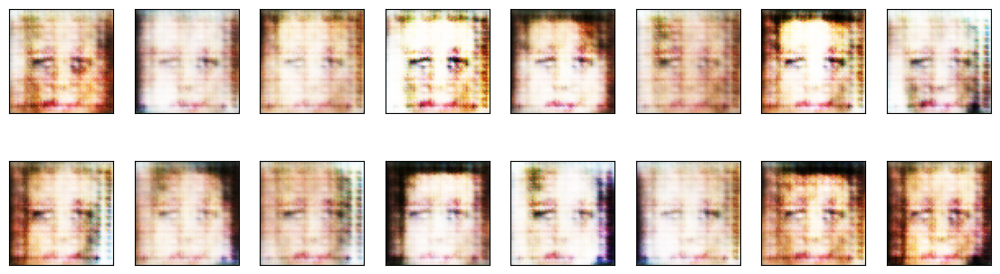

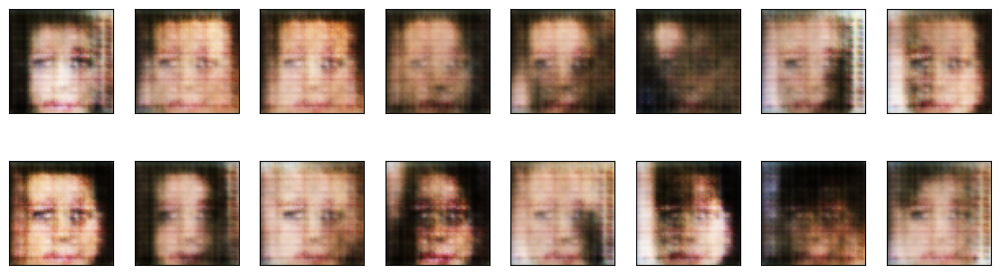

2024-01-23 23:45:19 | Epoch [2/50] | Batch 0/509 | d_loss: 1.1891 | g_loss: 1.6441
2024-01-23 23:45:22 | Epoch [2/50] | Batch 50/509 | d_loss: 1.1860 | g_loss: 1.5151
2024-01-23 23:45:25 | Epoch [2/50] | Batch 100/509 | d_loss: 0.9818 | g_loss: 2.1805
2024-01-23 23:45:27 | Epoch [2/50] | Batch 150/509 | d_loss: 1.2634 | g_loss: 2.3270
2024-01-23 23:45:30 | Epoch [2/50] | Batch 200/509 | d_loss: 1.2238 | g_loss: 1.6686
2024-01-23 23:45:33 | Epoch [2/50] | Batch 250/509 | d_loss: 1.0455 | g_loss: 2.4676
2024-01-23 23:45:36 | Epoch [2/50] | Batch 300/509 | d_loss: 1.1042 | g_loss: 1.8585
2024-01-23 23:45:39 | Epoch [2/50] | Batch 350/509 | d_loss: 1.0835 | g_loss: 2.3098
2024-01-23 23:45:42 | Epoch [2/50] | Batch 400/509 | d_loss: 1.1230 | g_loss: 2.0777
2024-01-23 23:45:45 | Epoch [2/50] | Batch 450/509 | d_loss: 1.3288 | g_loss: 2.3777
2024-01-23 23:45:48 | Epoch [2/50] | Batch 500/509 | d_loss: 1.0321 | g_loss: 2.3572


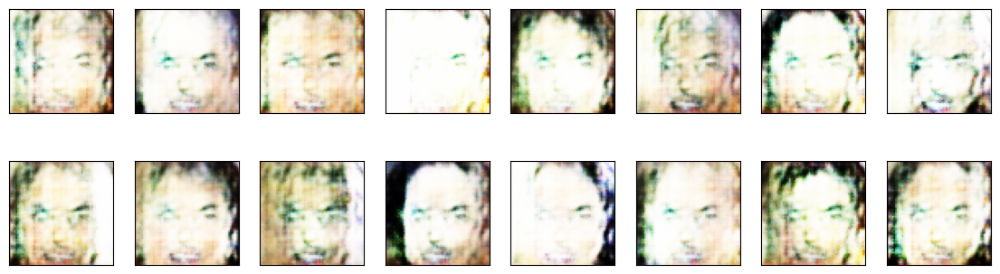

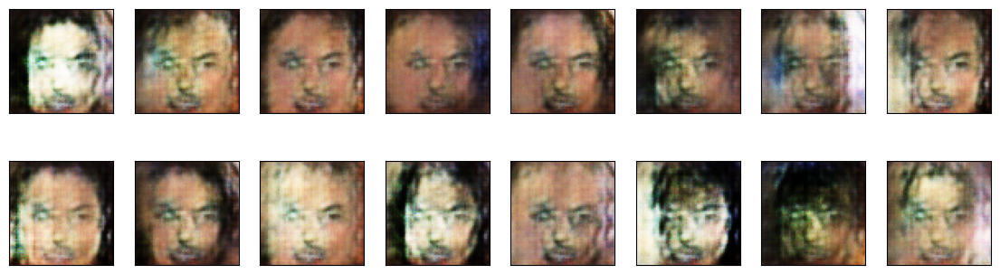

2024-01-23 23:45:50 | Epoch [3/50] | Batch 0/509 | d_loss: 1.0820 | g_loss: 1.8939
2024-01-23 23:45:53 | Epoch [3/50] | Batch 50/509 | d_loss: 1.1677 | g_loss: 2.1498
2024-01-23 23:45:56 | Epoch [3/50] | Batch 100/509 | d_loss: 1.1579 | g_loss: 1.6440
2024-01-23 23:45:59 | Epoch [3/50] | Batch 150/509 | d_loss: 1.3554 | g_loss: 1.7007
2024-01-23 23:46:01 | Epoch [3/50] | Batch 200/509 | d_loss: 1.0456 | g_loss: 1.8677
2024-01-23 23:46:04 | Epoch [3/50] | Batch 250/509 | d_loss: 1.2002 | g_loss: 1.7730
2024-01-23 23:46:07 | Epoch [3/50] | Batch 300/509 | d_loss: 1.2953 | g_loss: 2.3285
2024-01-23 23:46:10 | Epoch [3/50] | Batch 350/509 | d_loss: 1.0425 | g_loss: 1.8428
2024-01-23 23:46:13 | Epoch [3/50] | Batch 400/509 | d_loss: 1.1972 | g_loss: 1.9395
2024-01-23 23:46:16 | Epoch [3/50] | Batch 450/509 | d_loss: 0.9836 | g_loss: 1.9214
2024-01-23 23:46:19 | Epoch [3/50] | Batch 500/509 | d_loss: 1.1238 | g_loss: 2.1776


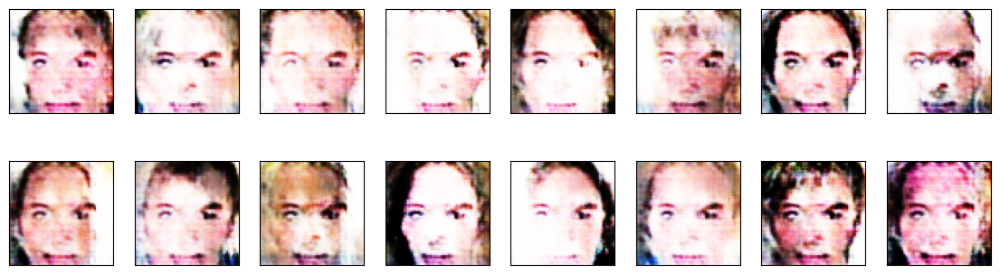

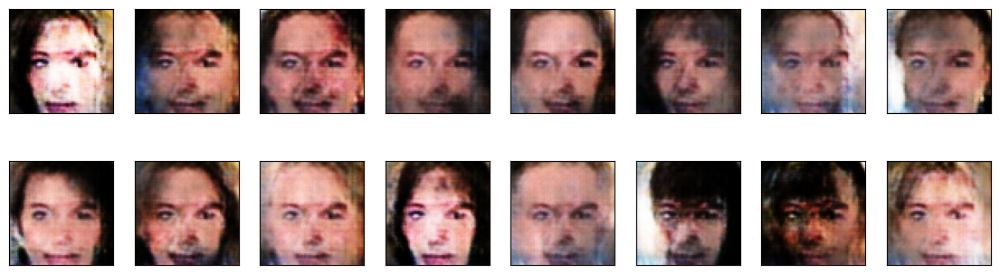

2024-01-23 23:46:21 | Epoch [4/50] | Batch 0/509 | d_loss: 1.3757 | g_loss: 2.1266
2024-01-23 23:46:24 | Epoch [4/50] | Batch 50/509 | d_loss: 1.0694 | g_loss: 1.9632
2024-01-23 23:46:27 | Epoch [4/50] | Batch 100/509 | d_loss: 0.9824 | g_loss: 1.5680
2024-01-23 23:46:30 | Epoch [4/50] | Batch 150/509 | d_loss: 1.2771 | g_loss: 1.8032
2024-01-23 23:46:33 | Epoch [4/50] | Batch 200/509 | d_loss: 1.1836 | g_loss: 1.3950
2024-01-23 23:46:35 | Epoch [4/50] | Batch 250/509 | d_loss: 0.9902 | g_loss: 2.3055
2024-01-23 23:46:38 | Epoch [4/50] | Batch 300/509 | d_loss: 1.0604 | g_loss: 2.3857
2024-01-23 23:46:41 | Epoch [4/50] | Batch 350/509 | d_loss: 0.9841 | g_loss: 1.8693
2024-01-23 23:46:44 | Epoch [4/50] | Batch 400/509 | d_loss: 1.3944 | g_loss: 2.1931
2024-01-23 23:46:47 | Epoch [4/50] | Batch 450/509 | d_loss: 1.3972 | g_loss: 0.5057
2024-01-23 23:46:50 | Epoch [4/50] | Batch 500/509 | d_loss: 1.3279 | g_loss: 1.5566


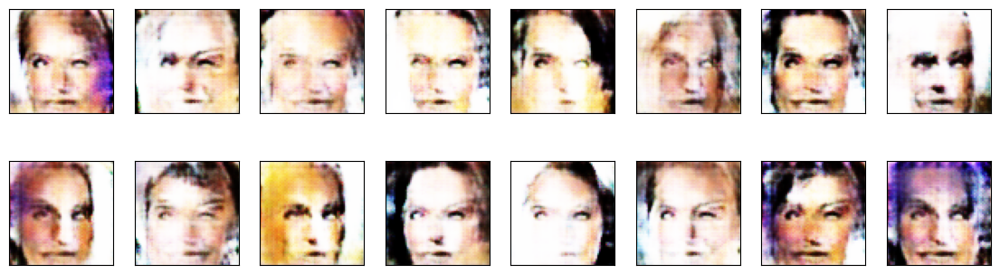

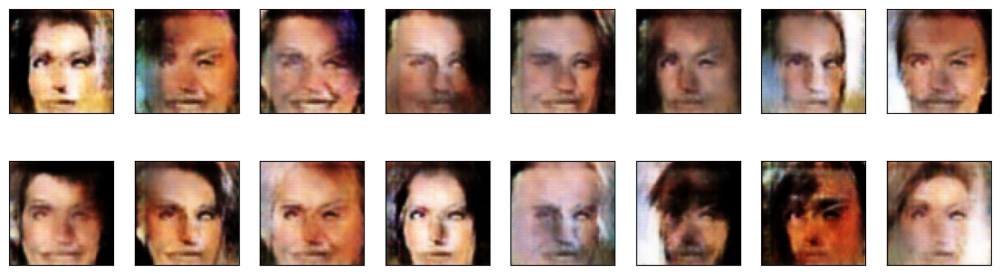

2024-01-23 23:46:52 | Epoch [5/50] | Batch 0/509 | d_loss: 1.2298 | g_loss: 1.6692
2024-01-23 23:46:55 | Epoch [5/50] | Batch 50/509 | d_loss: 1.2606 | g_loss: 1.5350
2024-01-23 23:46:58 | Epoch [5/50] | Batch 100/509 | d_loss: 1.0071 | g_loss: 2.4197
2024-01-23 23:47:01 | Epoch [5/50] | Batch 150/509 | d_loss: 1.1282 | g_loss: 2.5227
2024-01-23 23:47:03 | Epoch [5/50] | Batch 200/509 | d_loss: 1.6652 | g_loss: 1.1782
2024-01-23 23:47:06 | Epoch [5/50] | Batch 250/509 | d_loss: 1.2104 | g_loss: 1.9318
2024-01-23 23:47:09 | Epoch [5/50] | Batch 300/509 | d_loss: 1.0174 | g_loss: 1.8321
2024-01-23 23:47:12 | Epoch [5/50] | Batch 350/509 | d_loss: 1.0325 | g_loss: 2.1708
2024-01-23 23:47:15 | Epoch [5/50] | Batch 400/509 | d_loss: 1.0517 | g_loss: 1.3014
2024-01-23 23:47:18 | Epoch [5/50] | Batch 450/509 | d_loss: 1.0023 | g_loss: 1.4158
2024-01-23 23:47:21 | Epoch [5/50] | Batch 500/509 | d_loss: 1.1882 | g_loss: 2.1005


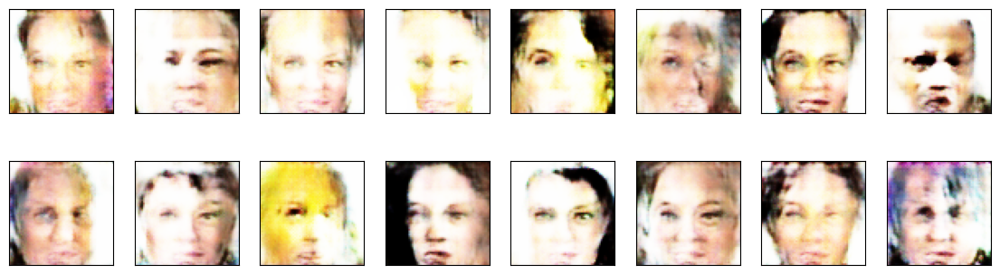

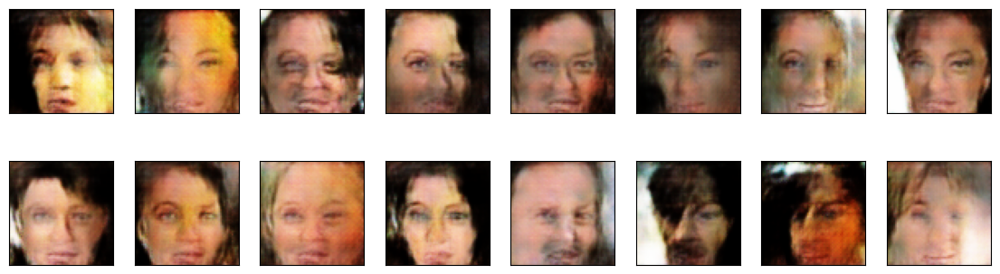

2024-01-23 23:47:23 | Epoch [6/50] | Batch 0/509 | d_loss: 1.0050 | g_loss: 1.7485
2024-01-23 23:47:26 | Epoch [6/50] | Batch 50/509 | d_loss: 1.0979 | g_loss: 1.6278
2024-01-23 23:47:29 | Epoch [6/50] | Batch 100/509 | d_loss: 1.0971 | g_loss: 1.4173
2024-01-23 23:47:32 | Epoch [6/50] | Batch 150/509 | d_loss: 1.2650 | g_loss: 1.7809
2024-01-23 23:47:35 | Epoch [6/50] | Batch 200/509 | d_loss: 1.2328 | g_loss: 2.4879
2024-01-23 23:47:37 | Epoch [6/50] | Batch 250/509 | d_loss: 1.0384 | g_loss: 2.5290
2024-01-23 23:47:40 | Epoch [6/50] | Batch 300/509 | d_loss: 1.2422 | g_loss: 1.2786
2024-01-23 23:47:43 | Epoch [6/50] | Batch 350/509 | d_loss: 1.1435 | g_loss: 2.2049
2024-01-23 23:47:46 | Epoch [6/50] | Batch 400/509 | d_loss: 1.0565 | g_loss: 2.2765
2024-01-23 23:47:49 | Epoch [6/50] | Batch 450/509 | d_loss: 0.9690 | g_loss: 2.0847
2024-01-23 23:47:52 | Epoch [6/50] | Batch 500/509 | d_loss: 1.2943 | g_loss: 1.1804


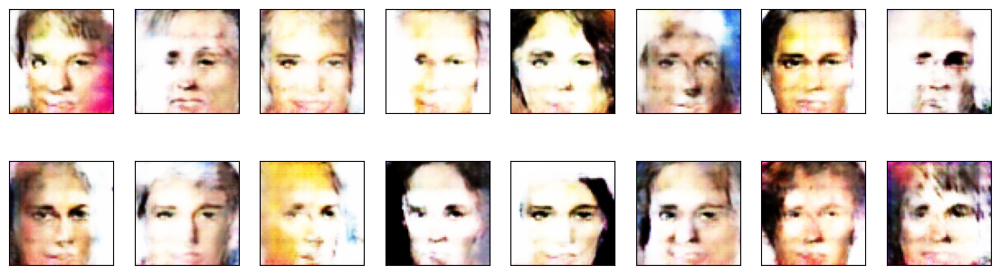

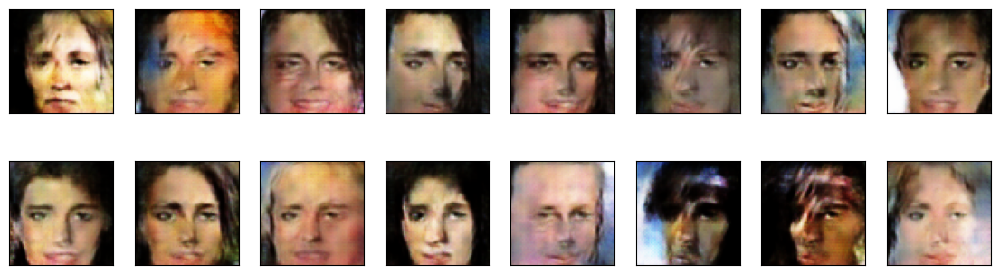

2024-01-23 23:47:54 | Epoch [7/50] | Batch 0/509 | d_loss: 1.0148 | g_loss: 2.4955
2024-01-23 23:47:57 | Epoch [7/50] | Batch 50/509 | d_loss: 1.1025 | g_loss: 1.5785
2024-01-23 23:48:00 | Epoch [7/50] | Batch 100/509 | d_loss: 0.9991 | g_loss: 2.1579
2024-01-23 23:48:03 | Epoch [7/50] | Batch 150/509 | d_loss: 1.0964 | g_loss: 1.9512
2024-01-23 23:48:06 | Epoch [7/50] | Batch 200/509 | d_loss: 1.0537 | g_loss: 1.3671
2024-01-23 23:48:09 | Epoch [7/50] | Batch 250/509 | d_loss: 1.2056 | g_loss: 2.5235
2024-01-23 23:48:11 | Epoch [7/50] | Batch 300/509 | d_loss: 1.2779 | g_loss: 0.9560
2024-01-23 23:48:14 | Epoch [7/50] | Batch 350/509 | d_loss: 1.3321 | g_loss: 0.7855
2024-01-23 23:48:17 | Epoch [7/50] | Batch 400/509 | d_loss: 1.1228 | g_loss: 1.6334
2024-01-23 23:48:20 | Epoch [7/50] | Batch 450/509 | d_loss: 1.1989 | g_loss: 1.6055
2024-01-23 23:48:23 | Epoch [7/50] | Batch 500/509 | d_loss: 1.2417 | g_loss: 1.3565


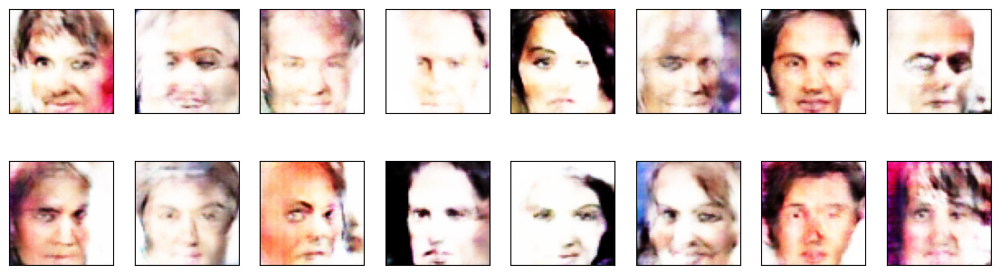

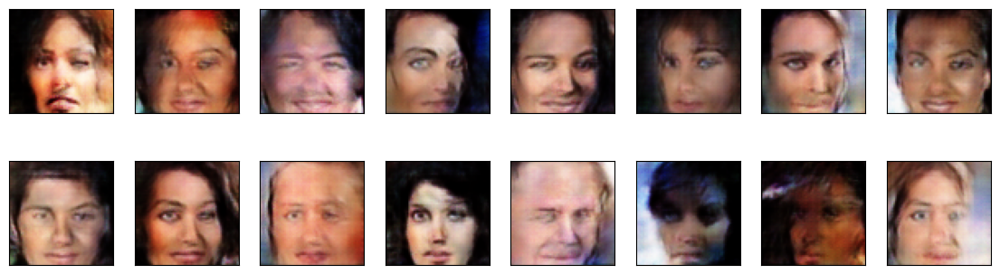

2024-01-23 23:48:25 | Epoch [8/50] | Batch 0/509 | d_loss: 1.1688 | g_loss: 1.2533
2024-01-23 23:48:28 | Epoch [8/50] | Batch 50/509 | d_loss: 1.0464 | g_loss: 1.4329
2024-01-23 23:48:31 | Epoch [8/50] | Batch 100/509 | d_loss: 1.0797 | g_loss: 1.6136
2024-01-23 23:48:34 | Epoch [8/50] | Batch 150/509 | d_loss: 1.3451 | g_loss: 0.9347
2024-01-23 23:48:37 | Epoch [8/50] | Batch 200/509 | d_loss: 1.1801 | g_loss: 1.0480
2024-01-23 23:48:40 | Epoch [8/50] | Batch 250/509 | d_loss: 1.0494 | g_loss: 1.6504
2024-01-23 23:48:43 | Epoch [8/50] | Batch 300/509 | d_loss: 1.2227 | g_loss: 1.2389
2024-01-23 23:48:45 | Epoch [8/50] | Batch 350/509 | d_loss: 1.0923 | g_loss: 1.3737
2024-01-23 23:48:48 | Epoch [8/50] | Batch 400/509 | d_loss: 1.0583 | g_loss: 1.5199
2024-01-23 23:48:51 | Epoch [8/50] | Batch 450/509 | d_loss: 1.1998 | g_loss: 1.7512
2024-01-23 23:48:54 | Epoch [8/50] | Batch 500/509 | d_loss: 1.1498 | g_loss: 1.8462


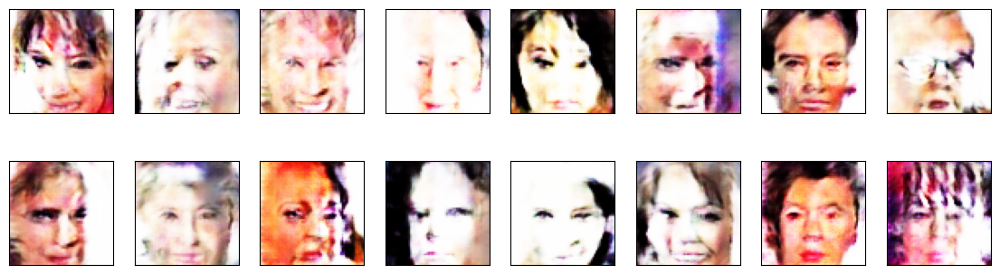

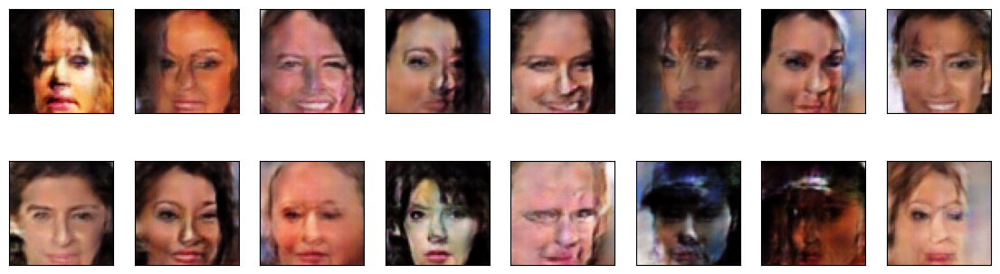

2024-01-23 23:48:56 | Epoch [9/50] | Batch 0/509 | d_loss: 1.0678 | g_loss: 1.5049
2024-01-23 23:48:59 | Epoch [9/50] | Batch 50/509 | d_loss: 1.0603 | g_loss: 1.7253
2024-01-23 23:49:02 | Epoch [9/50] | Batch 100/509 | d_loss: 1.3450 | g_loss: 0.8780
2024-01-23 23:49:05 | Epoch [9/50] | Batch 150/509 | d_loss: 1.2194 | g_loss: 0.9751
2024-01-23 23:49:08 | Epoch [9/50] | Batch 200/509 | d_loss: 1.0778 | g_loss: 1.2887
2024-01-23 23:49:11 | Epoch [9/50] | Batch 250/509 | d_loss: 1.2779 | g_loss: 0.7168
2024-01-23 23:49:14 | Epoch [9/50] | Batch 300/509 | d_loss: 1.1079 | g_loss: 1.2543
2024-01-23 23:49:16 | Epoch [9/50] | Batch 350/509 | d_loss: 1.1551 | g_loss: 1.7628
2024-01-23 23:49:19 | Epoch [9/50] | Batch 400/509 | d_loss: 1.1728 | g_loss: 1.8941
2024-01-23 23:49:22 | Epoch [9/50] | Batch 450/509 | d_loss: 1.3119 | g_loss: 2.0145
2024-01-23 23:49:25 | Epoch [9/50] | Batch 500/509 | d_loss: 1.3273 | g_loss: 1.1035


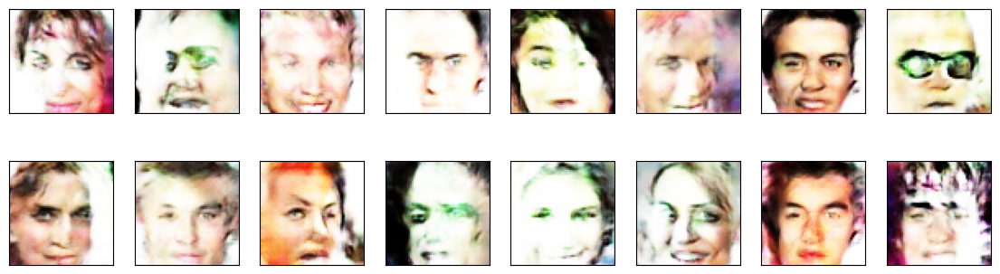

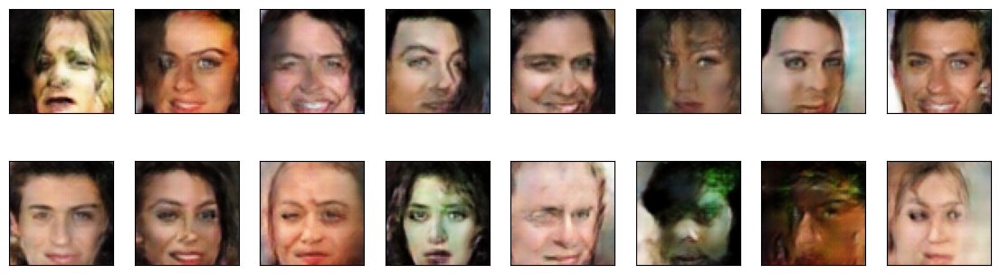

2024-01-23 23:49:27 | Epoch [10/50] | Batch 0/509 | d_loss: 0.8666 | g_loss: 1.7126
2024-01-23 23:49:30 | Epoch [10/50] | Batch 50/509 | d_loss: 1.1326 | g_loss: 1.6698
2024-01-23 23:49:33 | Epoch [10/50] | Batch 100/509 | d_loss: 0.9860 | g_loss: 1.5736
2024-01-23 23:49:36 | Epoch [10/50] | Batch 150/509 | d_loss: 1.0760 | g_loss: 1.1703
2024-01-23 23:49:39 | Epoch [10/50] | Batch 200/509 | d_loss: 1.2479 | g_loss: 1.3322
2024-01-23 23:49:42 | Epoch [10/50] | Batch 250/509 | d_loss: 1.2607 | g_loss: 1.9717
2024-01-23 23:49:44 | Epoch [10/50] | Batch 300/509 | d_loss: 1.1602 | g_loss: 1.4675
2024-01-23 23:49:47 | Epoch [10/50] | Batch 350/509 | d_loss: 0.9371 | g_loss: 1.5873
2024-01-23 23:49:50 | Epoch [10/50] | Batch 400/509 | d_loss: 1.2073 | g_loss: 2.1069
2024-01-23 23:49:53 | Epoch [10/50] | Batch 450/509 | d_loss: 1.0120 | g_loss: 1.1119
2024-01-23 23:49:56 | Epoch [10/50] | Batch 500/509 | d_loss: 1.1550 | g_loss: 1.5003


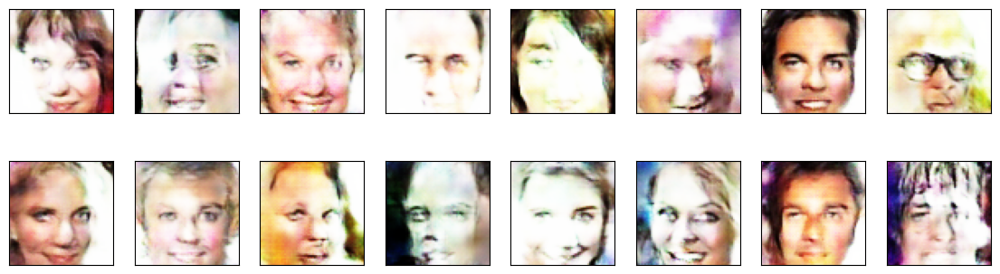

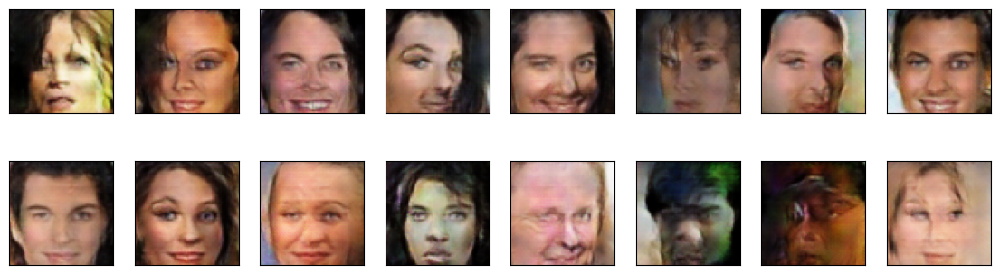

2024-01-23 23:49:58 | Epoch [11/50] | Batch 0/509 | d_loss: 1.1152 | g_loss: 1.5261
2024-01-23 23:50:01 | Epoch [11/50] | Batch 50/509 | d_loss: 1.1933 | g_loss: 1.3868
2024-01-23 23:50:04 | Epoch [11/50] | Batch 100/509 | d_loss: 0.9999 | g_loss: 1.6221
2024-01-23 23:50:07 | Epoch [11/50] | Batch 150/509 | d_loss: 1.1554 | g_loss: 1.4956
2024-01-23 23:50:10 | Epoch [11/50] | Batch 200/509 | d_loss: 0.9287 | g_loss: 2.0297
2024-01-23 23:50:13 | Epoch [11/50] | Batch 250/509 | d_loss: 1.0730 | g_loss: 1.1151
2024-01-23 23:50:16 | Epoch [11/50] | Batch 300/509 | d_loss: 1.0182 | g_loss: 1.2134
2024-01-23 23:50:19 | Epoch [11/50] | Batch 350/509 | d_loss: 1.2080 | g_loss: 1.5266
2024-01-23 23:50:21 | Epoch [11/50] | Batch 400/509 | d_loss: 1.1064 | g_loss: 1.3997
2024-01-23 23:50:24 | Epoch [11/50] | Batch 450/509 | d_loss: 1.1114 | g_loss: 1.4441
2024-01-23 23:50:27 | Epoch [11/50] | Batch 500/509 | d_loss: 1.1150 | g_loss: 1.3435


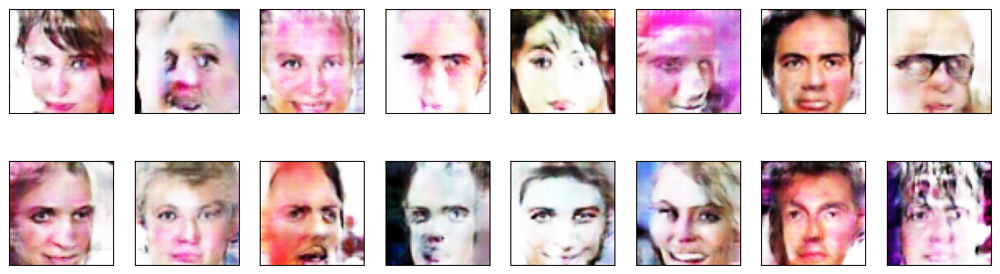

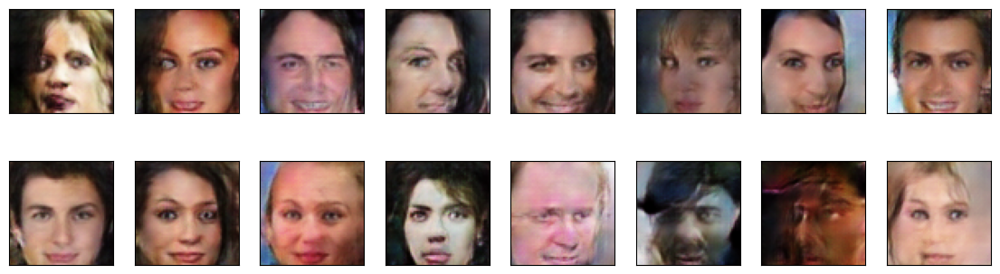

2024-01-23 23:50:29 | Epoch [12/50] | Batch 0/509 | d_loss: 1.1485 | g_loss: 1.8145
2024-01-23 23:50:32 | Epoch [12/50] | Batch 50/509 | d_loss: 1.0737 | g_loss: 1.1566
2024-01-23 23:50:35 | Epoch [12/50] | Batch 100/509 | d_loss: 0.9275 | g_loss: 1.2355
2024-01-23 23:50:38 | Epoch [12/50] | Batch 150/509 | d_loss: 1.0261 | g_loss: 1.1709
2024-01-23 23:50:41 | Epoch [12/50] | Batch 200/509 | d_loss: 1.7159 | g_loss: 3.0819
2024-01-23 23:50:44 | Epoch [12/50] | Batch 250/509 | d_loss: 0.9941 | g_loss: 1.6358
2024-01-23 23:50:47 | Epoch [12/50] | Batch 300/509 | d_loss: 1.1188 | g_loss: 1.3749
2024-01-23 23:50:50 | Epoch [12/50] | Batch 350/509 | d_loss: 0.9484 | g_loss: 2.0194
2024-01-23 23:50:53 | Epoch [12/50] | Batch 400/509 | d_loss: 1.1337 | g_loss: 1.4496
2024-01-23 23:50:55 | Epoch [12/50] | Batch 450/509 | d_loss: 1.0656 | g_loss: 1.4978
2024-01-23 23:50:58 | Epoch [12/50] | Batch 500/509 | d_loss: 1.1187 | g_loss: 1.3293


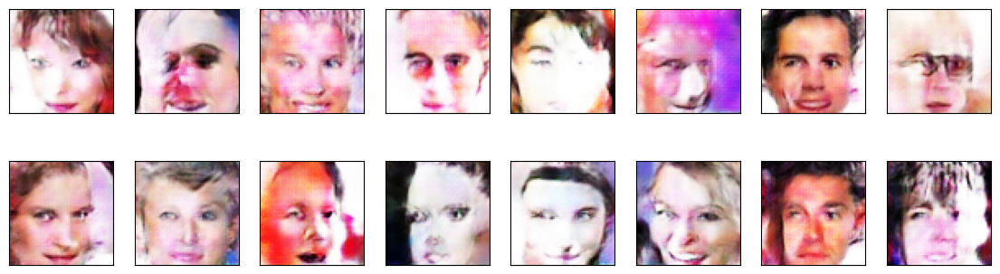

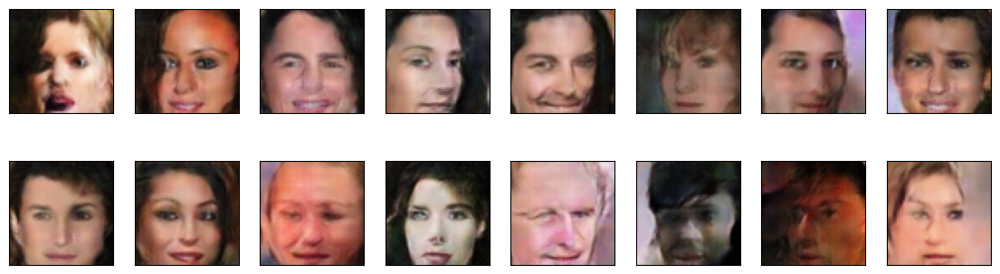

2024-01-23 23:51:00 | Epoch [13/50] | Batch 0/509 | d_loss: 1.1574 | g_loss: 0.9505
2024-01-23 23:51:03 | Epoch [13/50] | Batch 50/509 | d_loss: 1.4041 | g_loss: 3.0932
2024-01-23 23:51:06 | Epoch [13/50] | Batch 100/509 | d_loss: 1.0730 | g_loss: 1.3789
2024-01-23 23:51:09 | Epoch [13/50] | Batch 150/509 | d_loss: 0.8550 | g_loss: 1.9914
2024-01-23 23:51:12 | Epoch [13/50] | Batch 200/509 | d_loss: 1.1579 | g_loss: 1.5769
2024-01-23 23:51:15 | Epoch [13/50] | Batch 250/509 | d_loss: 0.9597 | g_loss: 1.5865
2024-01-23 23:51:18 | Epoch [13/50] | Batch 300/509 | d_loss: 1.3694 | g_loss: 0.9461
2024-01-23 23:51:21 | Epoch [13/50] | Batch 350/509 | d_loss: 0.9797 | g_loss: 2.0032
2024-01-23 23:51:24 | Epoch [13/50] | Batch 400/509 | d_loss: 0.9986 | g_loss: 1.4287
2024-01-23 23:51:27 | Epoch [13/50] | Batch 450/509 | d_loss: 1.0501 | g_loss: 1.4537
2024-01-23 23:51:29 | Epoch [13/50] | Batch 500/509 | d_loss: 0.9847 | g_loss: 1.6729


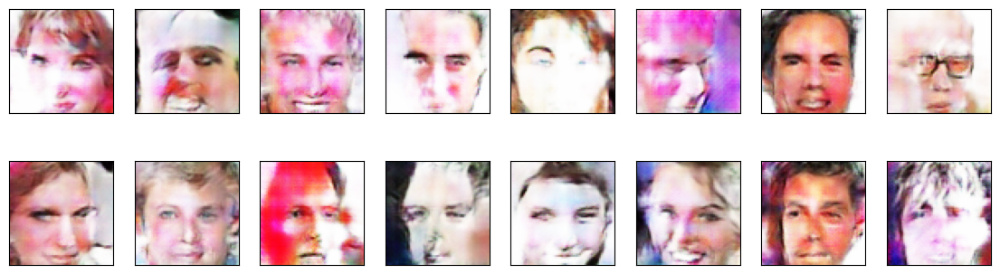

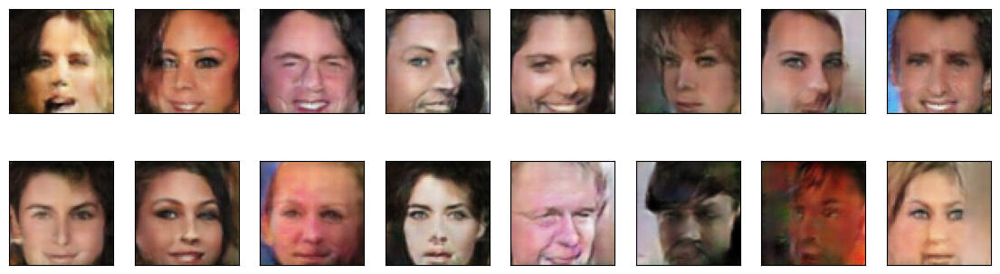

2024-01-23 23:51:31 | Epoch [14/50] | Batch 0/509 | d_loss: 1.2617 | g_loss: 0.8933
2024-01-23 23:51:34 | Epoch [14/50] | Batch 50/509 | d_loss: 1.0622 | g_loss: 1.3045
2024-01-23 23:51:37 | Epoch [14/50] | Batch 100/509 | d_loss: 0.9522 | g_loss: 2.1265
2024-01-23 23:51:40 | Epoch [14/50] | Batch 150/509 | d_loss: 1.1580 | g_loss: 1.2918
2024-01-23 23:51:43 | Epoch [14/50] | Batch 200/509 | d_loss: 1.1291 | g_loss: 1.6419
2024-01-23 23:51:46 | Epoch [14/50] | Batch 250/509 | d_loss: 1.0223 | g_loss: 1.4516
2024-01-23 23:51:49 | Epoch [14/50] | Batch 300/509 | d_loss: 1.1217 | g_loss: 2.3205
2024-01-23 23:51:52 | Epoch [14/50] | Batch 350/509 | d_loss: 0.9496 | g_loss: 1.9833
2024-01-23 23:51:55 | Epoch [14/50] | Batch 400/509 | d_loss: 1.1023 | g_loss: 1.1843
2024-01-23 23:51:58 | Epoch [14/50] | Batch 450/509 | d_loss: 1.5625 | g_loss: 1.1818
2024-01-23 23:52:01 | Epoch [14/50] | Batch 500/509 | d_loss: 0.9982 | g_loss: 2.2904


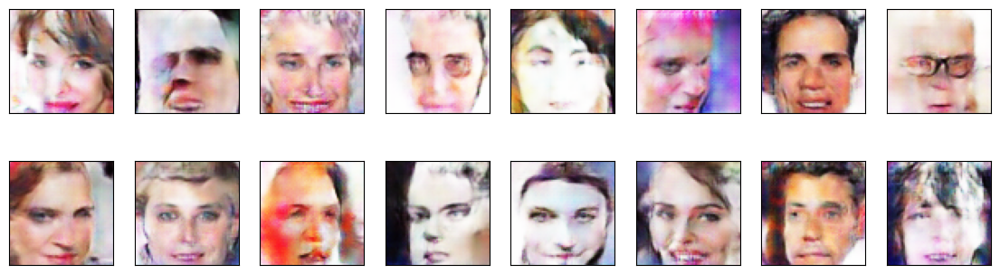

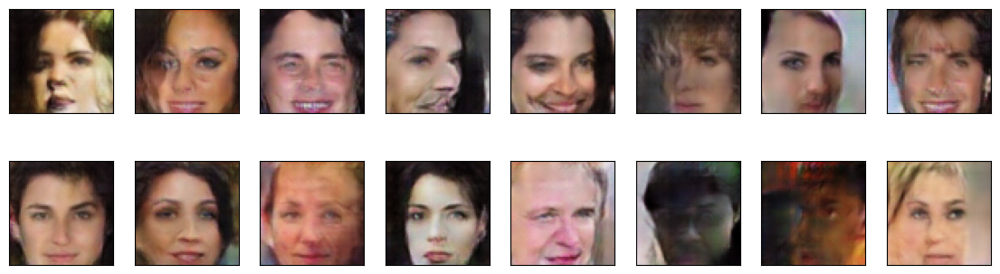

2024-01-23 23:52:02 | Epoch [15/50] | Batch 0/509 | d_loss: 0.9347 | g_loss: 1.5716
2024-01-23 23:52:05 | Epoch [15/50] | Batch 50/509 | d_loss: 0.8476 | g_loss: 2.4906
2024-01-23 23:52:08 | Epoch [15/50] | Batch 100/509 | d_loss: 0.9676 | g_loss: 2.5598
2024-01-23 23:52:11 | Epoch [15/50] | Batch 150/509 | d_loss: 0.9354 | g_loss: 1.8170
2024-01-23 23:52:14 | Epoch [15/50] | Batch 200/509 | d_loss: 1.1112 | g_loss: 1.5444
2024-01-23 23:52:17 | Epoch [15/50] | Batch 250/509 | d_loss: 1.0578 | g_loss: 1.0653
2024-01-23 23:52:20 | Epoch [15/50] | Batch 300/509 | d_loss: 1.4907 | g_loss: 0.7398
2024-01-23 23:52:23 | Epoch [15/50] | Batch 350/509 | d_loss: 0.9525 | g_loss: 1.6543
2024-01-23 23:52:26 | Epoch [15/50] | Batch 400/509 | d_loss: 1.1038 | g_loss: 1.0769
2024-01-23 23:52:29 | Epoch [15/50] | Batch 450/509 | d_loss: 1.0261 | g_loss: 1.3902
2024-01-23 23:52:32 | Epoch [15/50] | Batch 500/509 | d_loss: 1.1051 | g_loss: 1.6452


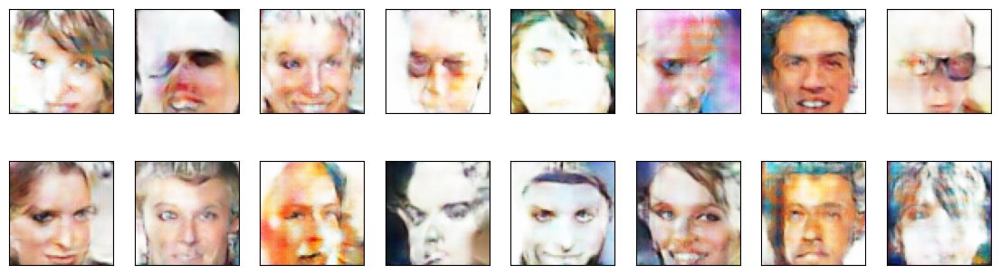

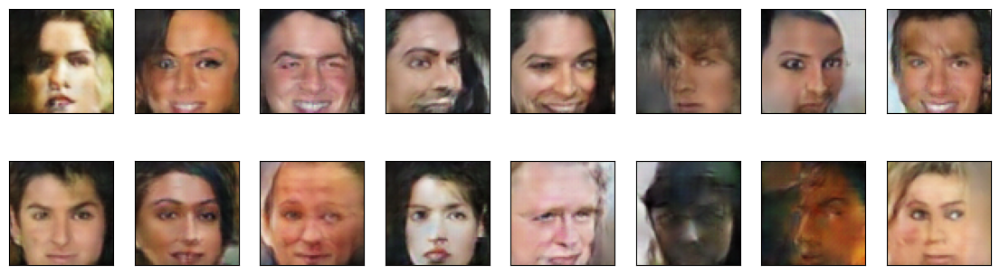

2024-01-23 23:52:33 | Epoch [16/50] | Batch 0/509 | d_loss: 0.8104 | g_loss: 2.0130
2024-01-23 23:52:36 | Epoch [16/50] | Batch 50/509 | d_loss: 0.7863 | g_loss: 1.5132
2024-01-23 23:52:39 | Epoch [16/50] | Batch 100/509 | d_loss: 0.9631 | g_loss: 2.4250
2024-01-23 23:52:42 | Epoch [16/50] | Batch 150/509 | d_loss: 0.8755 | g_loss: 2.1308
2024-01-23 23:52:45 | Epoch [16/50] | Batch 200/509 | d_loss: 0.9307 | g_loss: 1.7867
2024-01-23 23:52:48 | Epoch [16/50] | Batch 250/509 | d_loss: 1.0354 | g_loss: 1.6461
2024-01-23 23:52:51 | Epoch [16/50] | Batch 300/509 | d_loss: 1.1359 | g_loss: 1.8136
2024-01-23 23:52:54 | Epoch [16/50] | Batch 350/509 | d_loss: 1.2423 | g_loss: 2.4332
2024-01-23 23:52:57 | Epoch [16/50] | Batch 400/509 | d_loss: 0.9293 | g_loss: 1.6681
2024-01-23 23:53:00 | Epoch [16/50] | Batch 450/509 | d_loss: 1.1363 | g_loss: 2.2811
2024-01-23 23:53:03 | Epoch [16/50] | Batch 500/509 | d_loss: 1.0749 | g_loss: 1.7965


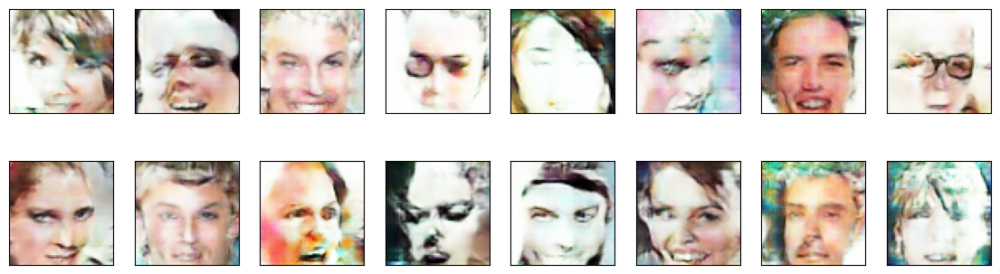

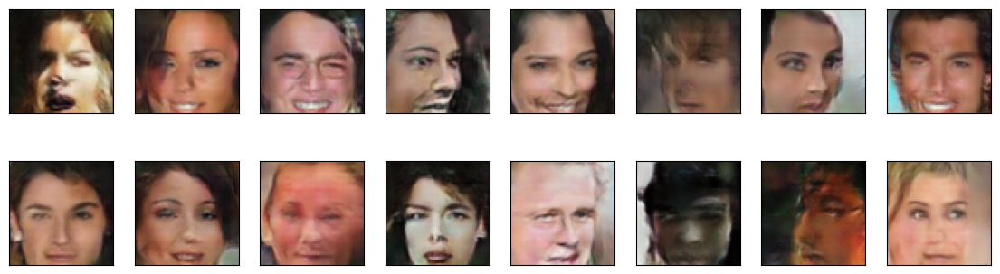

2024-01-23 23:53:05 | Epoch [17/50] | Batch 0/509 | d_loss: 1.4908 | g_loss: 2.8444
2024-01-23 23:53:07 | Epoch [17/50] | Batch 50/509 | d_loss: 0.9047 | g_loss: 1.7045
2024-01-23 23:53:10 | Epoch [17/50] | Batch 100/509 | d_loss: 0.8546 | g_loss: 1.6177
2024-01-23 23:53:13 | Epoch [17/50] | Batch 150/509 | d_loss: 1.0879 | g_loss: 1.7492
2024-01-23 23:53:16 | Epoch [17/50] | Batch 200/509 | d_loss: 0.8336 | g_loss: 2.4891
2024-01-23 23:53:19 | Epoch [17/50] | Batch 250/509 | d_loss: 0.7493 | g_loss: 2.5936
2024-01-23 23:53:22 | Epoch [17/50] | Batch 300/509 | d_loss: 0.8572 | g_loss: 2.3227
2024-01-23 23:53:25 | Epoch [17/50] | Batch 350/509 | d_loss: 1.0287 | g_loss: 0.9942
2024-01-23 23:53:28 | Epoch [17/50] | Batch 400/509 | d_loss: 0.9642 | g_loss: 1.5836
2024-01-23 23:53:31 | Epoch [17/50] | Batch 450/509 | d_loss: 0.9066 | g_loss: 1.3815
2024-01-23 23:53:34 | Epoch [17/50] | Batch 500/509 | d_loss: 0.8503 | g_loss: 1.6554


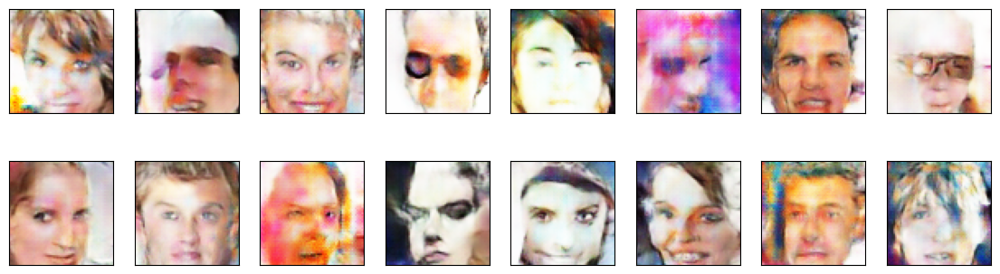

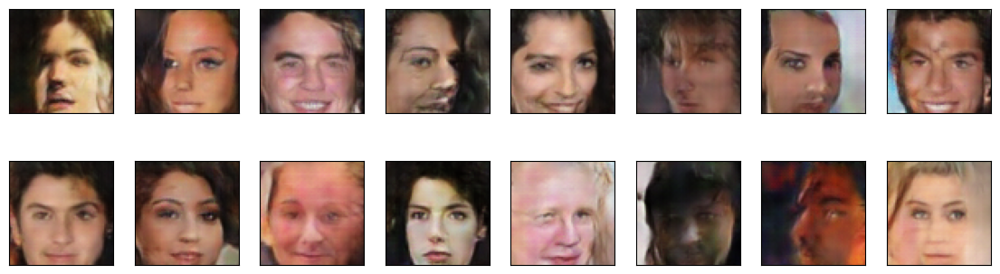

2024-01-23 23:53:36 | Epoch [18/50] | Batch 0/509 | d_loss: 0.9314 | g_loss: 1.8514
2024-01-23 23:53:39 | Epoch [18/50] | Batch 50/509 | d_loss: 0.9700 | g_loss: 2.2030
2024-01-23 23:53:41 | Epoch [18/50] | Batch 100/509 | d_loss: 1.0879 | g_loss: 2.4024
2024-01-23 23:53:44 | Epoch [18/50] | Batch 150/509 | d_loss: 1.0126 | g_loss: 1.0279
2024-01-23 23:53:47 | Epoch [18/50] | Batch 200/509 | d_loss: 0.7217 | g_loss: 2.0515
2024-01-23 23:53:50 | Epoch [18/50] | Batch 250/509 | d_loss: 0.9439 | g_loss: 1.4500
2024-01-23 23:53:53 | Epoch [18/50] | Batch 300/509 | d_loss: 0.9285 | g_loss: 1.8528
2024-01-23 23:53:56 | Epoch [18/50] | Batch 350/509 | d_loss: 0.8371 | g_loss: 2.1181
2024-01-23 23:53:59 | Epoch [18/50] | Batch 400/509 | d_loss: 0.8343 | g_loss: 2.0859
2024-01-23 23:54:02 | Epoch [18/50] | Batch 450/509 | d_loss: 1.1406 | g_loss: 3.0658
2024-01-23 23:54:05 | Epoch [18/50] | Batch 500/509 | d_loss: 0.9564 | g_loss: 1.2820


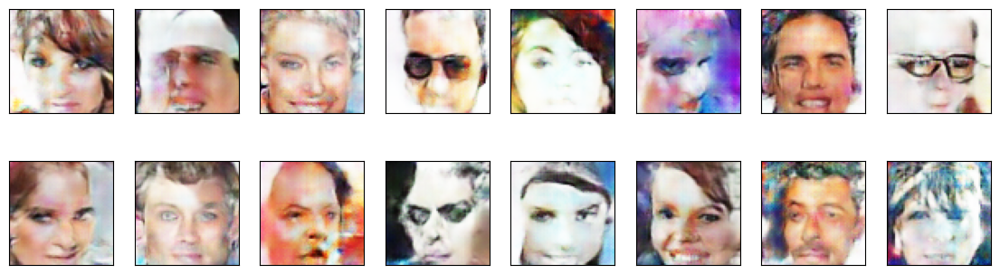

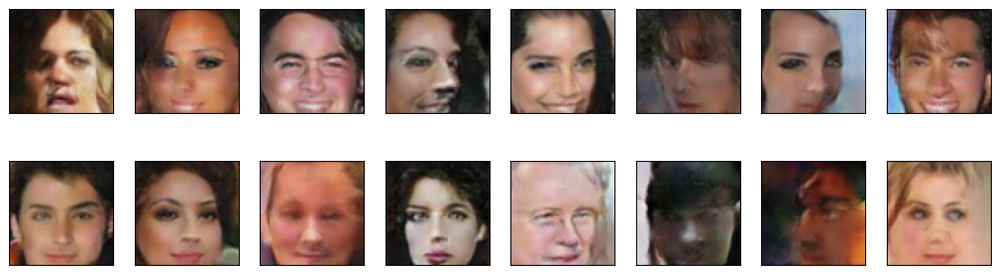

2024-01-23 23:54:07 | Epoch [19/50] | Batch 0/509 | d_loss: 0.9264 | g_loss: 1.4358
2024-01-23 23:54:10 | Epoch [19/50] | Batch 50/509 | d_loss: 0.9070 | g_loss: 1.9280
2024-01-23 23:54:13 | Epoch [19/50] | Batch 100/509 | d_loss: 1.0042 | g_loss: 2.3121
2024-01-23 23:54:15 | Epoch [19/50] | Batch 150/509 | d_loss: 0.7741 | g_loss: 1.7969
2024-01-23 23:54:18 | Epoch [19/50] | Batch 200/509 | d_loss: 1.0821 | g_loss: 1.0829
2024-01-23 23:54:21 | Epoch [19/50] | Batch 250/509 | d_loss: 1.2027 | g_loss: 2.8367
2024-01-23 23:54:24 | Epoch [19/50] | Batch 300/509 | d_loss: 0.8509 | g_loss: 1.5699
2024-01-23 23:54:27 | Epoch [19/50] | Batch 350/509 | d_loss: 0.8191 | g_loss: 1.1945
2024-01-23 23:54:30 | Epoch [19/50] | Batch 400/509 | d_loss: 1.0188 | g_loss: 1.8877
2024-01-23 23:54:33 | Epoch [19/50] | Batch 450/509 | d_loss: 1.1272 | g_loss: 1.3245
2024-01-23 23:54:36 | Epoch [19/50] | Batch 500/509 | d_loss: 0.7326 | g_loss: 2.0496


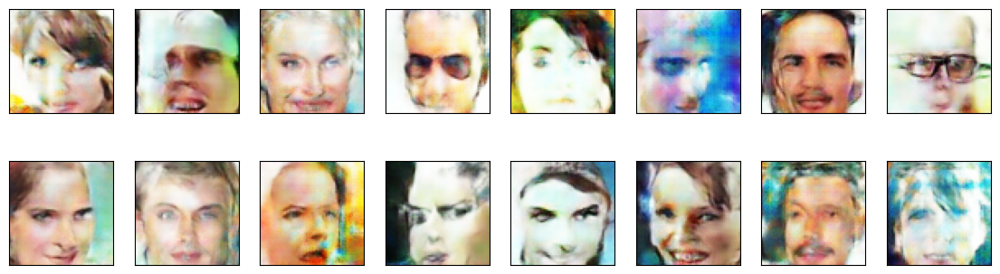

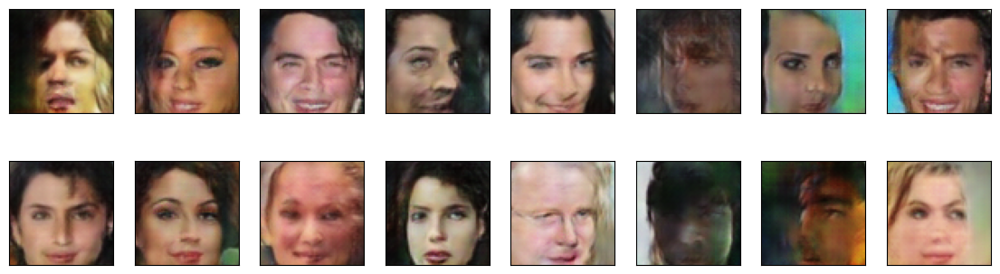

2024-01-23 23:54:38 | Epoch [20/50] | Batch 0/509 | d_loss: 0.8622 | g_loss: 3.2255
2024-01-23 23:54:41 | Epoch [20/50] | Batch 50/509 | d_loss: 0.6671 | g_loss: 1.8947
2024-01-23 23:54:44 | Epoch [20/50] | Batch 100/509 | d_loss: 0.7075 | g_loss: 1.8958
2024-01-23 23:54:46 | Epoch [20/50] | Batch 150/509 | d_loss: 0.8582 | g_loss: 1.9053
2024-01-23 23:54:49 | Epoch [20/50] | Batch 200/509 | d_loss: 0.8615 | g_loss: 2.3031
2024-01-23 23:54:52 | Epoch [20/50] | Batch 250/509 | d_loss: 0.7298 | g_loss: 2.4300
2024-01-23 23:54:55 | Epoch [20/50] | Batch 300/509 | d_loss: 0.6833 | g_loss: 2.0793
2024-01-23 23:54:58 | Epoch [20/50] | Batch 350/509 | d_loss: 0.9276 | g_loss: 2.1028
2024-01-23 23:55:01 | Epoch [20/50] | Batch 400/509 | d_loss: 0.9861 | g_loss: 2.6864
2024-01-23 23:55:04 | Epoch [20/50] | Batch 450/509 | d_loss: 1.3024 | g_loss: 3.8205
2024-01-23 23:55:07 | Epoch [20/50] | Batch 500/509 | d_loss: 1.4308 | g_loss: 4.4290


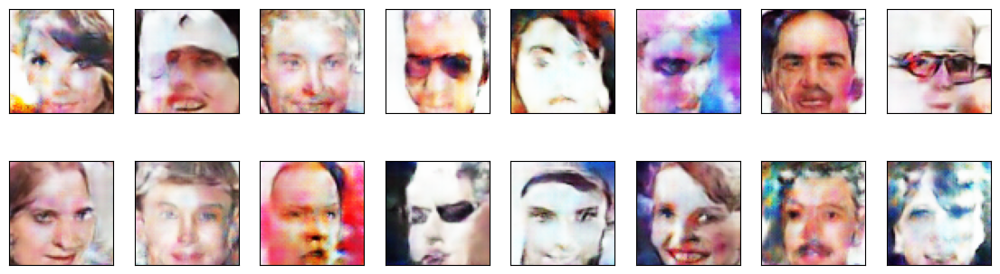

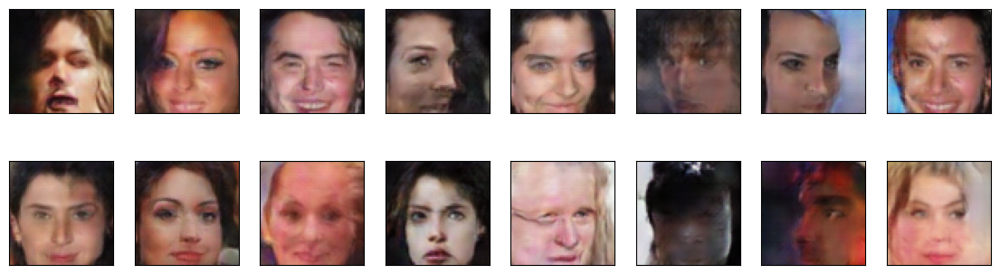

2024-01-23 23:55:09 | Epoch [21/50] | Batch 0/509 | d_loss: 0.7522 | g_loss: 2.1859
2024-01-23 23:55:12 | Epoch [21/50] | Batch 50/509 | d_loss: 0.7505 | g_loss: 2.1048
2024-01-23 23:55:15 | Epoch [21/50] | Batch 100/509 | d_loss: 0.7913 | g_loss: 1.5965
2024-01-23 23:55:18 | Epoch [21/50] | Batch 150/509 | d_loss: 0.7991 | g_loss: 1.6876
2024-01-23 23:55:20 | Epoch [21/50] | Batch 200/509 | d_loss: 0.8000 | g_loss: 1.8856
2024-01-23 23:55:23 | Epoch [21/50] | Batch 250/509 | d_loss: 1.0363 | g_loss: 1.5655
2024-01-23 23:55:26 | Epoch [21/50] | Batch 300/509 | d_loss: 0.7389 | g_loss: 1.8092
2024-01-23 23:55:29 | Epoch [21/50] | Batch 350/509 | d_loss: 0.6931 | g_loss: 1.8229
2024-01-23 23:55:32 | Epoch [21/50] | Batch 400/509 | d_loss: 0.7894 | g_loss: 1.4057
2024-01-23 23:55:35 | Epoch [21/50] | Batch 450/509 | d_loss: 0.7818 | g_loss: 1.8944
2024-01-23 23:55:38 | Epoch [21/50] | Batch 500/509 | d_loss: 0.8934 | g_loss: 1.4518


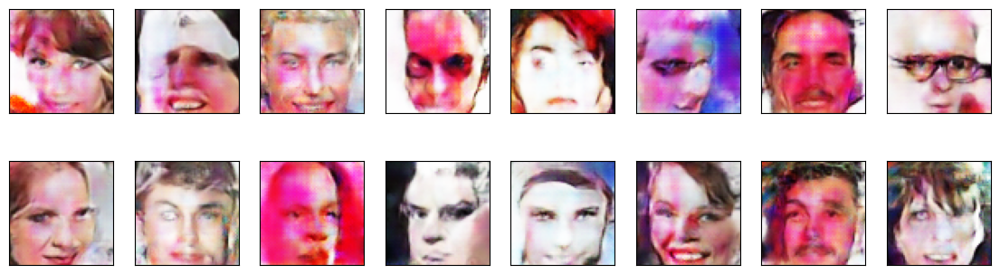

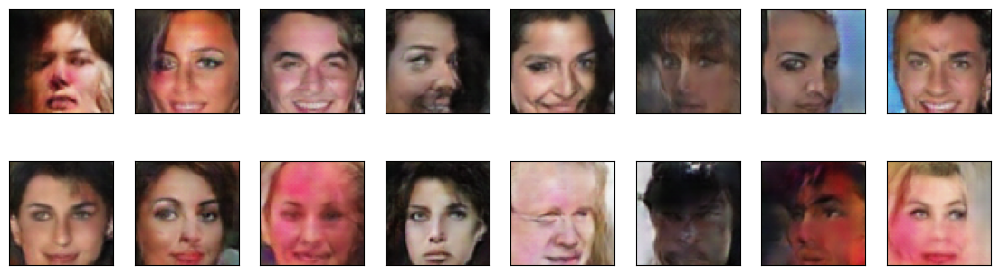

2024-01-23 23:55:40 | Epoch [22/50] | Batch 0/509 | d_loss: 0.8276 | g_loss: 1.4692
2024-01-23 23:55:43 | Epoch [22/50] | Batch 50/509 | d_loss: 0.8202 | g_loss: 2.2311
2024-01-23 23:55:46 | Epoch [22/50] | Batch 100/509 | d_loss: 0.7627 | g_loss: 2.4733
2024-01-23 23:55:49 | Epoch [22/50] | Batch 150/509 | d_loss: 0.7878 | g_loss: 1.8403
2024-01-23 23:55:52 | Epoch [22/50] | Batch 200/509 | d_loss: 0.8460 | g_loss: 2.5889
2024-01-23 23:55:54 | Epoch [22/50] | Batch 250/509 | d_loss: 1.0411 | g_loss: 3.0124
2024-01-23 23:55:57 | Epoch [22/50] | Batch 300/509 | d_loss: 0.7040 | g_loss: 2.4175
2024-01-23 23:56:00 | Epoch [22/50] | Batch 350/509 | d_loss: 0.8325 | g_loss: 1.1295
2024-01-23 23:56:03 | Epoch [22/50] | Batch 400/509 | d_loss: 0.6623 | g_loss: 1.7994
2024-01-23 23:56:06 | Epoch [22/50] | Batch 450/509 | d_loss: 0.8078 | g_loss: 1.3424
2024-01-23 23:56:09 | Epoch [22/50] | Batch 500/509 | d_loss: 0.9729 | g_loss: 2.3636


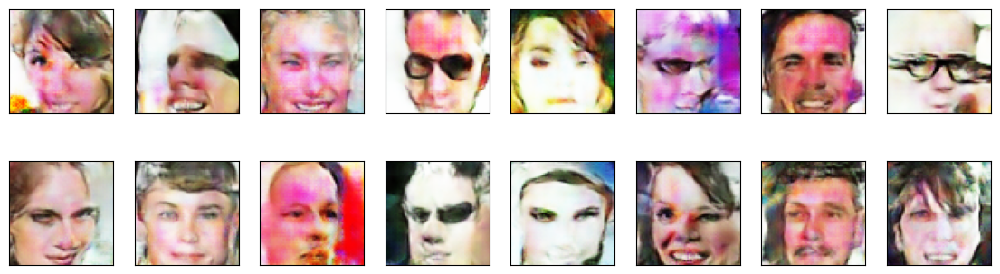

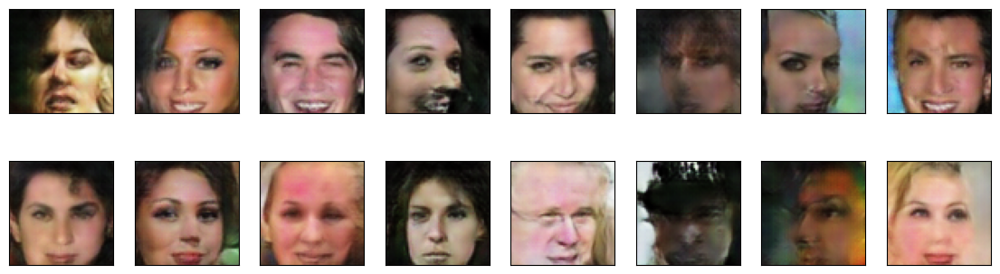

2024-01-23 23:56:11 | Epoch [23/50] | Batch 0/509 | d_loss: 0.9342 | g_loss: 3.8758
2024-01-23 23:56:14 | Epoch [23/50] | Batch 50/509 | d_loss: 1.1776 | g_loss: 3.1913
2024-01-23 23:56:17 | Epoch [23/50] | Batch 100/509 | d_loss: 0.8398 | g_loss: 1.5782
2024-01-23 23:56:20 | Epoch [23/50] | Batch 150/509 | d_loss: 0.6865 | g_loss: 1.9392
2024-01-23 23:56:23 | Epoch [23/50] | Batch 200/509 | d_loss: 0.7801 | g_loss: 2.5710
2024-01-23 23:56:26 | Epoch [23/50] | Batch 250/509 | d_loss: 0.8937 | g_loss: 1.8419
2024-01-23 23:56:28 | Epoch [23/50] | Batch 300/509 | d_loss: 0.8632 | g_loss: 3.0904
2024-01-23 23:56:31 | Epoch [23/50] | Batch 350/509 | d_loss: 0.6128 | g_loss: 2.7658
2024-01-23 23:56:34 | Epoch [23/50] | Batch 400/509 | d_loss: 1.2285 | g_loss: 0.8976
2024-01-23 23:56:37 | Epoch [23/50] | Batch 450/509 | d_loss: 0.6693 | g_loss: 1.4055
2024-01-23 23:56:40 | Epoch [23/50] | Batch 500/509 | d_loss: 1.3385 | g_loss: 4.6576


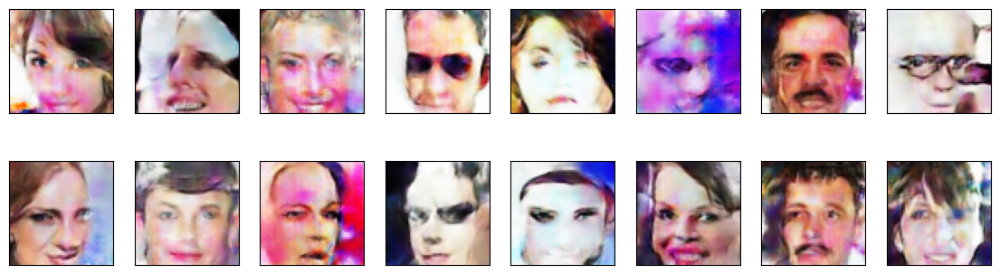

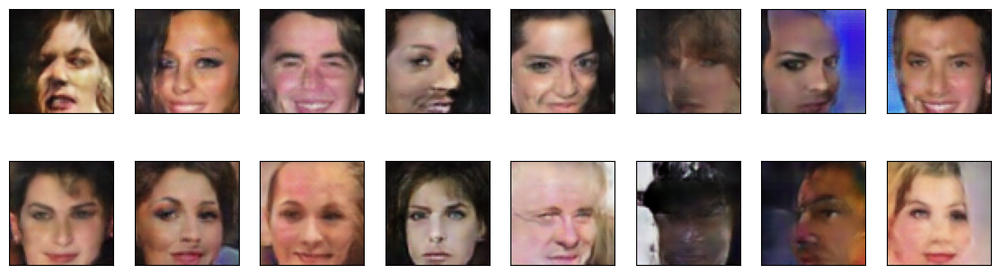

2024-01-23 23:56:42 | Epoch [24/50] | Batch 0/509 | d_loss: 0.8042 | g_loss: 1.3251
2024-01-23 23:56:45 | Epoch [24/50] | Batch 50/509 | d_loss: 0.7473 | g_loss: 1.7474
2024-01-23 23:56:48 | Epoch [24/50] | Batch 100/509 | d_loss: 0.5536 | g_loss: 2.5143
2024-01-23 23:56:51 | Epoch [24/50] | Batch 150/509 | d_loss: 1.0934 | g_loss: 0.9229
2024-01-23 23:56:54 | Epoch [24/50] | Batch 200/509 | d_loss: 0.7016 | g_loss: 2.9974
2024-01-23 23:56:57 | Epoch [24/50] | Batch 250/509 | d_loss: 0.8365 | g_loss: 2.1844
2024-01-23 23:56:59 | Epoch [24/50] | Batch 300/509 | d_loss: 0.6112 | g_loss: 3.7822
2024-01-23 23:57:02 | Epoch [24/50] | Batch 350/509 | d_loss: 0.6571 | g_loss: 2.0109
2024-01-23 23:57:05 | Epoch [24/50] | Batch 400/509 | d_loss: 0.8093 | g_loss: 4.2628
2024-01-23 23:57:08 | Epoch [24/50] | Batch 450/509 | d_loss: 0.6321 | g_loss: 1.9265
2024-01-23 23:57:11 | Epoch [24/50] | Batch 500/509 | d_loss: 0.6559 | g_loss: 1.9200


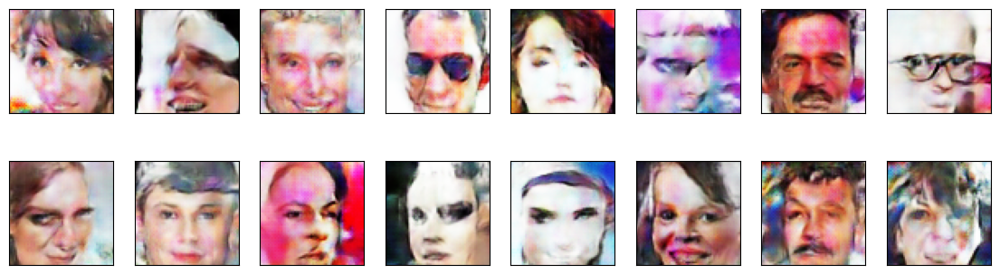

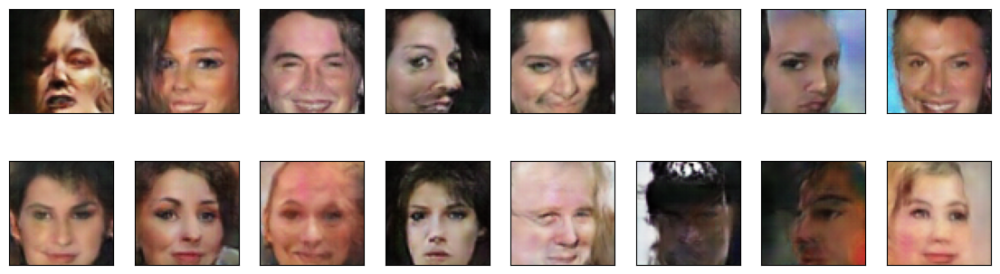

2024-01-23 23:57:13 | Epoch [25/50] | Batch 0/509 | d_loss: 0.8295 | g_loss: 2.5928
2024-01-23 23:57:16 | Epoch [25/50] | Batch 50/509 | d_loss: 0.6480 | g_loss: 2.6091
2024-01-23 23:57:19 | Epoch [25/50] | Batch 100/509 | d_loss: 0.8436 | g_loss: 2.8761
2024-01-23 23:57:22 | Epoch [25/50] | Batch 150/509 | d_loss: 0.6153 | g_loss: 2.3688
2024-01-23 23:57:25 | Epoch [25/50] | Batch 200/509 | d_loss: 0.5998 | g_loss: 1.9271
2024-01-23 23:57:28 | Epoch [25/50] | Batch 250/509 | d_loss: 0.6228 | g_loss: 2.8830
2024-01-23 23:57:31 | Epoch [25/50] | Batch 300/509 | d_loss: 1.3551 | g_loss: 2.5114
2024-01-23 23:57:33 | Epoch [25/50] | Batch 350/509 | d_loss: 0.6243 | g_loss: 3.6555
2024-01-23 23:57:36 | Epoch [25/50] | Batch 400/509 | d_loss: 0.8217 | g_loss: 1.6380
2024-01-23 23:57:39 | Epoch [25/50] | Batch 450/509 | d_loss: 0.5861 | g_loss: 2.6189
2024-01-23 23:57:42 | Epoch [25/50] | Batch 500/509 | d_loss: 0.6357 | g_loss: 2.2849


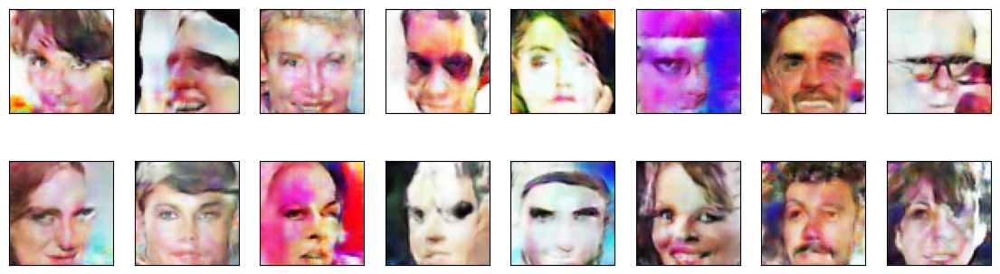

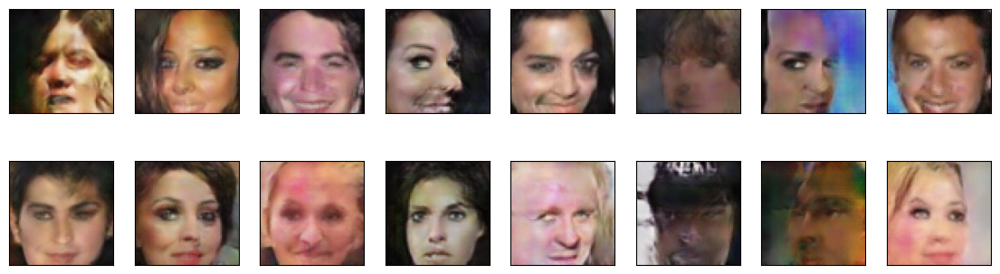

2024-01-23 23:57:44 | Epoch [26/50] | Batch 0/509 | d_loss: 0.6872 | g_loss: 1.7135
2024-01-23 23:57:47 | Epoch [26/50] | Batch 50/509 | d_loss: 0.7085 | g_loss: 3.0210
2024-01-23 23:57:50 | Epoch [26/50] | Batch 100/509 | d_loss: 0.6604 | g_loss: 2.0716
2024-01-23 23:57:53 | Epoch [26/50] | Batch 150/509 | d_loss: 0.9611 | g_loss: 1.2234
2024-01-23 23:57:56 | Epoch [26/50] | Batch 200/509 | d_loss: 0.5666 | g_loss: 1.8952
2024-01-23 23:57:59 | Epoch [26/50] | Batch 250/509 | d_loss: 0.6367 | g_loss: 1.8582
2024-01-23 23:58:02 | Epoch [26/50] | Batch 300/509 | d_loss: 0.7430 | g_loss: 3.7688
2024-01-23 23:58:05 | Epoch [26/50] | Batch 350/509 | d_loss: 0.6493 | g_loss: 2.2009
2024-01-23 23:58:07 | Epoch [26/50] | Batch 400/509 | d_loss: 0.6429 | g_loss: 2.3707
2024-01-23 23:58:10 | Epoch [26/50] | Batch 450/509 | d_loss: 0.7056 | g_loss: 1.7384
2024-01-23 23:58:13 | Epoch [26/50] | Batch 500/509 | d_loss: 0.7822 | g_loss: 2.6239


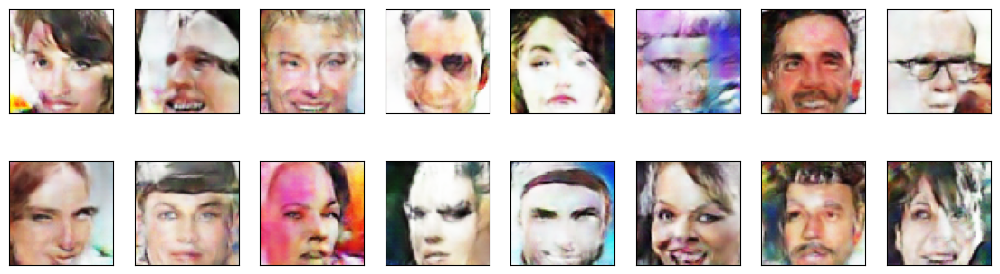

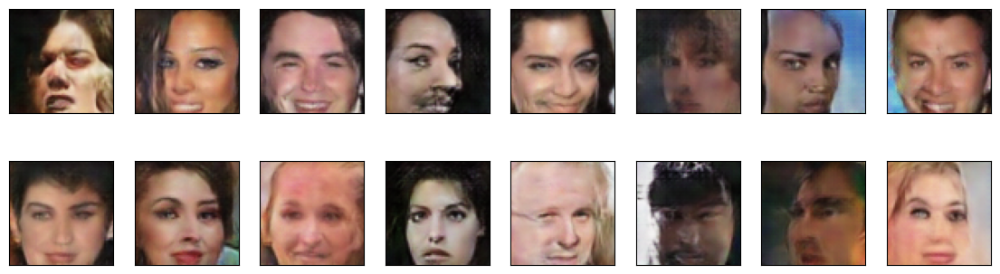

2024-01-23 23:58:15 | Epoch [27/50] | Batch 0/509 | d_loss: 0.7088 | g_loss: 2.5448
2024-01-23 23:58:18 | Epoch [27/50] | Batch 50/509 | d_loss: 0.6096 | g_loss: 2.1682
2024-01-23 23:58:21 | Epoch [27/50] | Batch 100/509 | d_loss: 0.6549 | g_loss: 2.8408
2024-01-23 23:58:24 | Epoch [27/50] | Batch 150/509 | d_loss: 0.4889 | g_loss: 2.3492
2024-01-23 23:58:27 | Epoch [27/50] | Batch 200/509 | d_loss: 0.8803 | g_loss: 1.4699
2024-01-23 23:58:30 | Epoch [27/50] | Batch 250/509 | d_loss: 1.1888 | g_loss: 4.4887
2024-01-23 23:58:33 | Epoch [27/50] | Batch 300/509 | d_loss: 0.5786 | g_loss: 1.7499
2024-01-23 23:58:36 | Epoch [27/50] | Batch 350/509 | d_loss: 0.8649 | g_loss: 3.7339
2024-01-23 23:58:39 | Epoch [27/50] | Batch 400/509 | d_loss: 0.7450 | g_loss: 3.5604
2024-01-23 23:58:41 | Epoch [27/50] | Batch 450/509 | d_loss: 0.4547 | g_loss: 3.6147
2024-01-23 23:58:44 | Epoch [27/50] | Batch 500/509 | d_loss: 0.7124 | g_loss: 3.1523


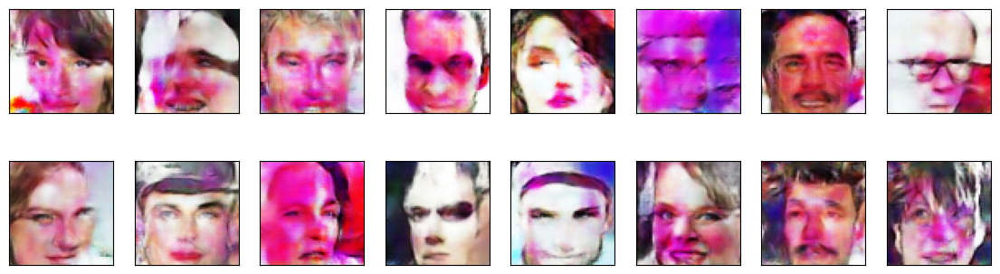

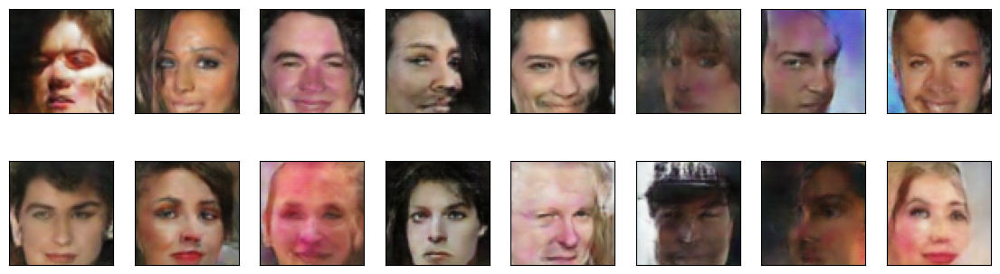

2024-01-23 23:58:46 | Epoch [28/50] | Batch 0/509 | d_loss: 0.5539 | g_loss: 3.1562
2024-01-23 23:58:49 | Epoch [28/50] | Batch 50/509 | d_loss: 1.2678 | g_loss: 4.6122
2024-01-23 23:58:52 | Epoch [28/50] | Batch 100/509 | d_loss: 0.5875 | g_loss: 2.5381
2024-01-23 23:58:55 | Epoch [28/50] | Batch 150/509 | d_loss: 0.5300 | g_loss: 2.6852
2024-01-23 23:58:58 | Epoch [28/50] | Batch 200/509 | d_loss: 0.4760 | g_loss: 2.9192
2024-01-23 23:59:01 | Epoch [28/50] | Batch 250/509 | d_loss: 0.7722 | g_loss: 2.3100
2024-01-23 23:59:04 | Epoch [28/50] | Batch 300/509 | d_loss: 0.8205 | g_loss: 2.1438
2024-01-23 23:59:07 | Epoch [28/50] | Batch 350/509 | d_loss: 0.9726 | g_loss: 4.2821
2024-01-23 23:59:10 | Epoch [28/50] | Batch 400/509 | d_loss: 0.6199 | g_loss: 2.5080
2024-01-23 23:59:13 | Epoch [28/50] | Batch 450/509 | d_loss: 0.7390 | g_loss: 4.2860
2024-01-23 23:59:15 | Epoch [28/50] | Batch 500/509 | d_loss: 0.7063 | g_loss: 3.0635


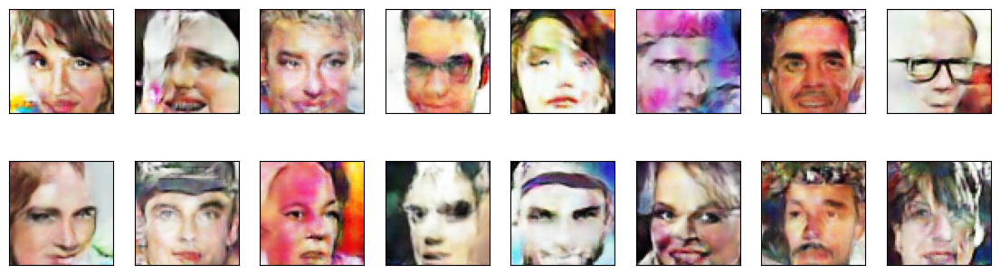

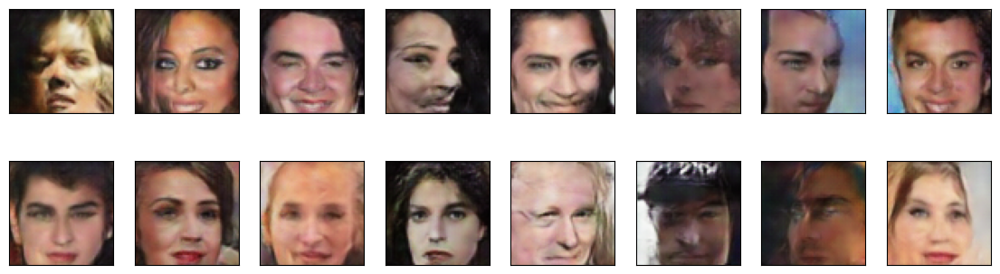

2024-01-23 23:59:17 | Epoch [29/50] | Batch 0/509 | d_loss: 0.4808 | g_loss: 2.8023
2024-01-23 23:59:20 | Epoch [29/50] | Batch 50/509 | d_loss: 0.5473 | g_loss: 1.8955
2024-01-23 23:59:23 | Epoch [29/50] | Batch 100/509 | d_loss: 0.7576 | g_loss: 1.4222
2024-01-23 23:59:26 | Epoch [29/50] | Batch 150/509 | d_loss: 0.4923 | g_loss: 2.6828
2024-01-23 23:59:29 | Epoch [29/50] | Batch 200/509 | d_loss: 0.6887 | g_loss: 3.7243
2024-01-23 23:59:32 | Epoch [29/50] | Batch 250/509 | d_loss: 0.5893 | g_loss: 2.0110
2024-01-23 23:59:35 | Epoch [29/50] | Batch 300/509 | d_loss: 0.6005 | g_loss: 2.7479
2024-01-23 23:59:38 | Epoch [29/50] | Batch 350/509 | d_loss: 0.7219 | g_loss: 3.1001
2024-01-23 23:59:41 | Epoch [29/50] | Batch 400/509 | d_loss: 0.5846 | g_loss: 2.9521
2024-01-23 23:59:44 | Epoch [29/50] | Batch 450/509 | d_loss: 0.7891 | g_loss: 2.1566
2024-01-23 23:59:46 | Epoch [29/50] | Batch 500/509 | d_loss: 0.5465 | g_loss: 3.1346


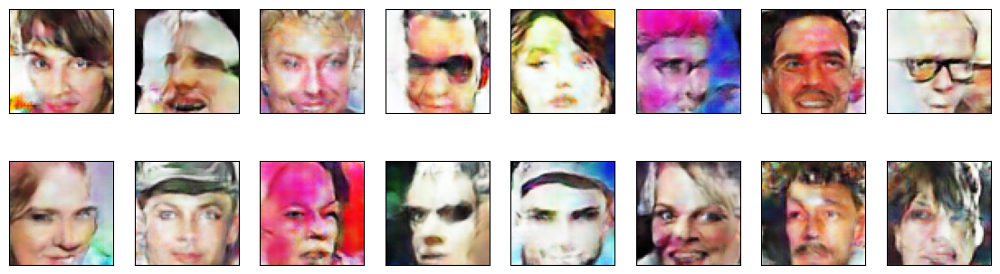

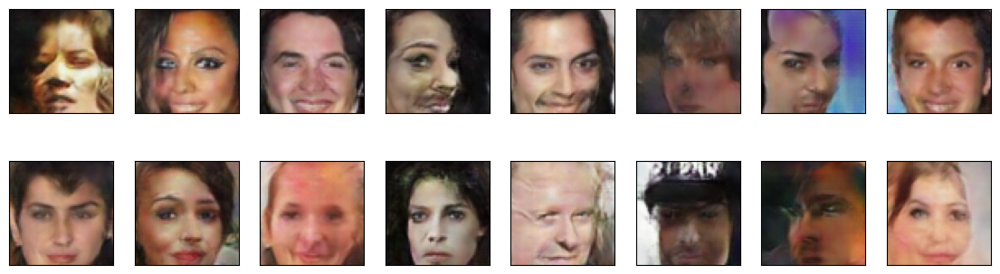

2024-01-23 23:59:48 | Epoch [30/50] | Batch 0/509 | d_loss: 0.6667 | g_loss: 3.0649
2024-01-23 23:59:51 | Epoch [30/50] | Batch 50/509 | d_loss: 0.4569 | g_loss: 3.0736
2024-01-23 23:59:54 | Epoch [30/50] | Batch 100/509 | d_loss: 0.4636 | g_loss: 3.0588
2024-01-23 23:59:57 | Epoch [30/50] | Batch 150/509 | d_loss: 0.6511 | g_loss: 1.7633
2024-01-24 00:00:00 | Epoch [30/50] | Batch 200/509 | d_loss: 1.6841 | g_loss: 3.7220
2024-01-24 00:00:03 | Epoch [30/50] | Batch 250/509 | d_loss: 0.5373 | g_loss: 2.4326
2024-01-24 00:00:06 | Epoch [30/50] | Batch 300/509 | d_loss: 0.4734 | g_loss: 1.9734
2024-01-24 00:00:09 | Epoch [30/50] | Batch 350/509 | d_loss: 0.5915 | g_loss: 2.1673
2024-01-24 00:00:12 | Epoch [30/50] | Batch 400/509 | d_loss: 0.5149 | g_loss: 3.2807
2024-01-24 00:00:15 | Epoch [30/50] | Batch 450/509 | d_loss: 0.5399 | g_loss: 2.1293
2024-01-24 00:00:18 | Epoch [30/50] | Batch 500/509 | d_loss: 1.0033 | g_loss: 2.1891


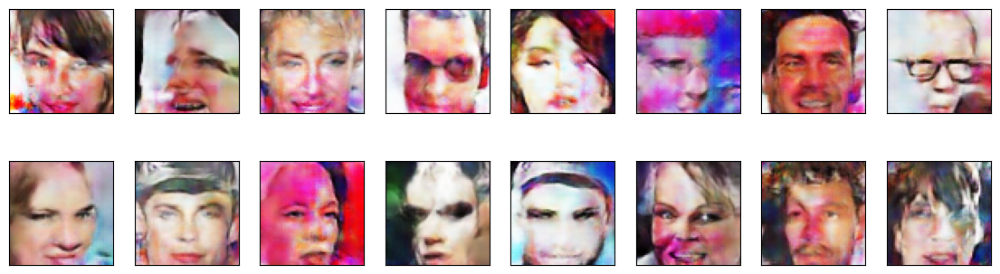

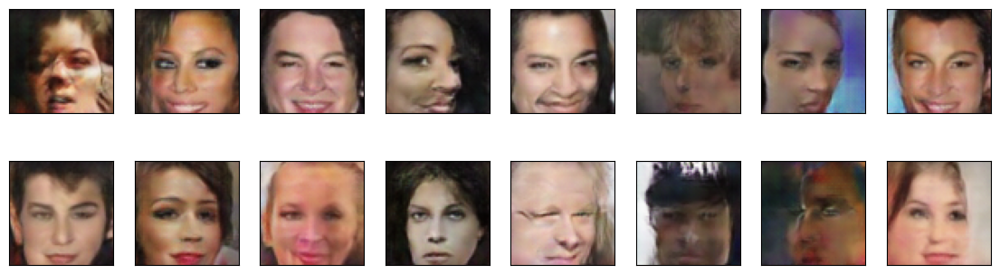

2024-01-24 00:00:20 | Epoch [31/50] | Batch 0/509 | d_loss: 0.5172 | g_loss: 3.1611
2024-01-24 00:00:22 | Epoch [31/50] | Batch 50/509 | d_loss: 0.5538 | g_loss: 2.7207
2024-01-24 00:00:25 | Epoch [31/50] | Batch 100/509 | d_loss: 0.6952 | g_loss: 1.5686
2024-01-24 00:00:28 | Epoch [31/50] | Batch 150/509 | d_loss: 0.4840 | g_loss: 2.8262
2024-01-24 00:00:31 | Epoch [31/50] | Batch 200/509 | d_loss: 1.5151 | g_loss: 2.2577
2024-01-24 00:00:34 | Epoch [31/50] | Batch 250/509 | d_loss: 0.4818 | g_loss: 2.9661
2024-01-24 00:00:37 | Epoch [31/50] | Batch 300/509 | d_loss: 0.5389 | g_loss: 1.8880
2024-01-24 00:00:40 | Epoch [31/50] | Batch 350/509 | d_loss: 0.5128 | g_loss: 2.3404
2024-01-24 00:00:43 | Epoch [31/50] | Batch 400/509 | d_loss: 0.6750 | g_loss: 2.1346
2024-01-24 00:00:46 | Epoch [31/50] | Batch 450/509 | d_loss: 0.6829 | g_loss: 1.6508
2024-01-24 00:00:49 | Epoch [31/50] | Batch 500/509 | d_loss: 0.6177 | g_loss: 2.2274


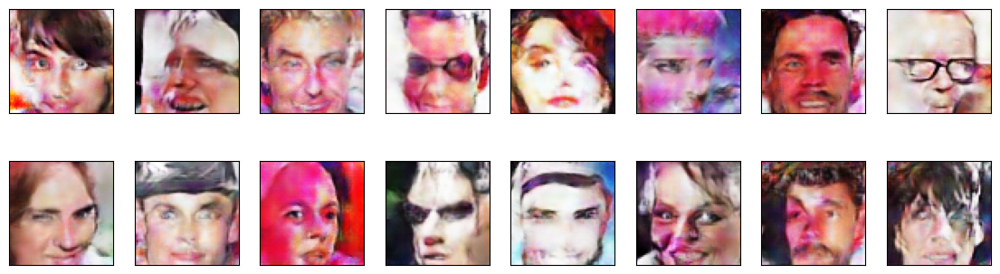

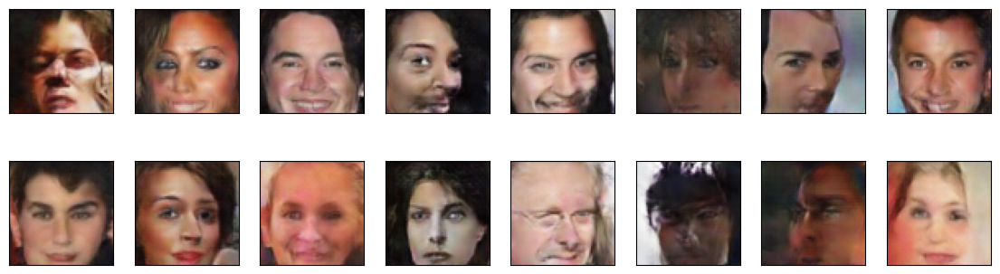

2024-01-24 00:00:51 | Epoch [32/50] | Batch 0/509 | d_loss: 0.5592 | g_loss: 2.0301
2024-01-24 00:00:54 | Epoch [32/50] | Batch 50/509 | d_loss: 0.5924 | g_loss: 3.1173
2024-01-24 00:00:56 | Epoch [32/50] | Batch 100/509 | d_loss: 0.6194 | g_loss: 2.4560
2024-01-24 00:00:59 | Epoch [32/50] | Batch 150/509 | d_loss: 0.4968 | g_loss: 2.8561
2024-01-24 00:01:02 | Epoch [32/50] | Batch 200/509 | d_loss: 0.9526 | g_loss: 1.7470
2024-01-24 00:01:05 | Epoch [32/50] | Batch 250/509 | d_loss: 0.4758 | g_loss: 2.6440
2024-01-24 00:01:08 | Epoch [32/50] | Batch 300/509 | d_loss: 0.4139 | g_loss: 3.3623
2024-01-24 00:01:11 | Epoch [32/50] | Batch 350/509 | d_loss: 0.4442 | g_loss: 3.1958
2024-01-24 00:01:14 | Epoch [32/50] | Batch 400/509 | d_loss: 0.5555 | g_loss: 2.6816
2024-01-24 00:01:17 | Epoch [32/50] | Batch 450/509 | d_loss: 0.4852 | g_loss: 1.9571
2024-01-24 00:01:20 | Epoch [32/50] | Batch 500/509 | d_loss: 0.8487 | g_loss: 1.7831


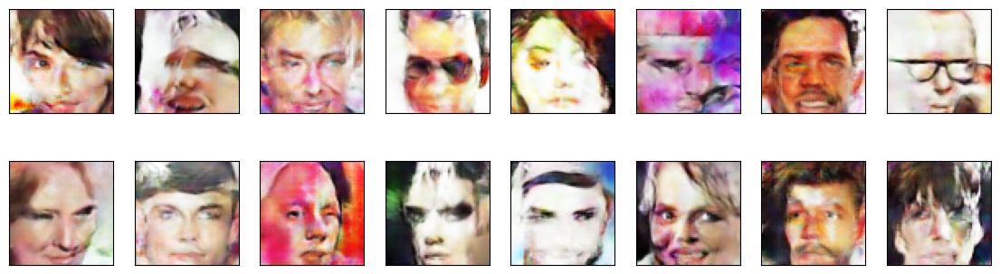

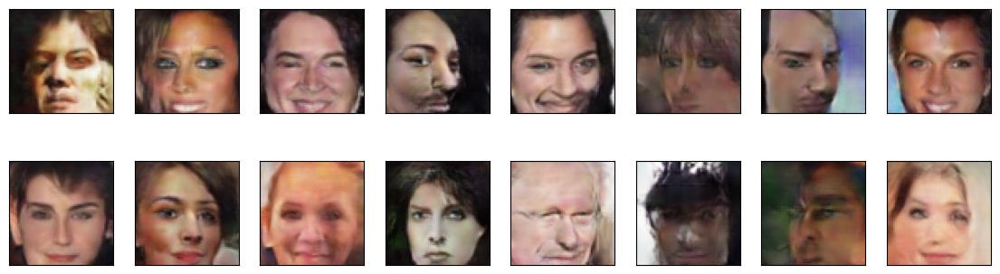

2024-01-24 00:01:22 | Epoch [33/50] | Batch 0/509 | d_loss: 0.5746 | g_loss: 3.0065
2024-01-24 00:01:25 | Epoch [33/50] | Batch 50/509 | d_loss: 0.4651 | g_loss: 3.3834
2024-01-24 00:01:28 | Epoch [33/50] | Batch 100/509 | d_loss: 0.4571 | g_loss: 3.0624
2024-01-24 00:01:30 | Epoch [33/50] | Batch 150/509 | d_loss: 0.5528 | g_loss: 2.9391
2024-01-24 00:01:33 | Epoch [33/50] | Batch 200/509 | d_loss: 0.5719 | g_loss: 3.8521
2024-01-24 00:01:36 | Epoch [33/50] | Batch 250/509 | d_loss: 0.4523 | g_loss: 3.5433
2024-01-24 00:01:39 | Epoch [33/50] | Batch 300/509 | d_loss: 0.5063 | g_loss: 3.0446
2024-01-24 00:01:42 | Epoch [33/50] | Batch 350/509 | d_loss: 0.4982 | g_loss: 2.9123
2024-01-24 00:01:45 | Epoch [33/50] | Batch 400/509 | d_loss: 0.5151 | g_loss: 3.2911
2024-01-24 00:01:48 | Epoch [33/50] | Batch 450/509 | d_loss: 0.6065 | g_loss: 1.6502
2024-01-24 00:01:51 | Epoch [33/50] | Batch 500/509 | d_loss: 0.5365 | g_loss: 2.7817


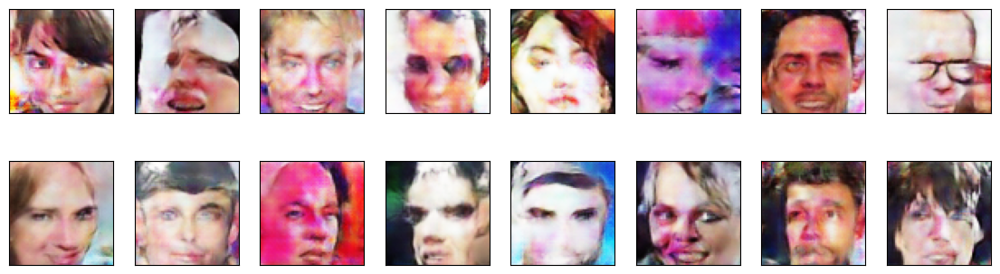

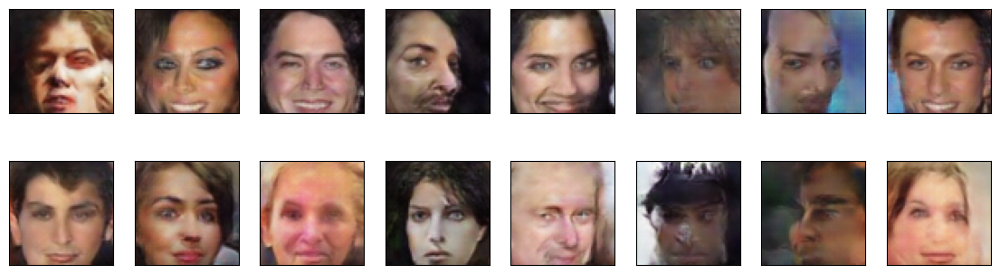

2024-01-24 00:01:53 | Epoch [34/50] | Batch 0/509 | d_loss: 0.5588 | g_loss: 2.0643
2024-01-24 00:01:56 | Epoch [34/50] | Batch 50/509 | d_loss: 0.5001 | g_loss: 3.5462
2024-01-24 00:01:59 | Epoch [34/50] | Batch 100/509 | d_loss: 0.4754 | g_loss: 3.3575
2024-01-24 00:02:01 | Epoch [34/50] | Batch 150/509 | d_loss: 0.5428 | g_loss: 2.2986
2024-01-24 00:02:04 | Epoch [34/50] | Batch 200/509 | d_loss: 0.5471 | g_loss: 2.2415
2024-01-24 00:02:07 | Epoch [34/50] | Batch 250/509 | d_loss: 0.6708 | g_loss: 3.0494
2024-01-24 00:02:10 | Epoch [34/50] | Batch 300/509 | d_loss: 0.5749 | g_loss: 2.5736
2024-01-24 00:02:13 | Epoch [34/50] | Batch 350/509 | d_loss: 0.4295 | g_loss: 2.8297
2024-01-24 00:02:16 | Epoch [34/50] | Batch 400/509 | d_loss: 0.4849 | g_loss: 4.3515
2024-01-24 00:02:19 | Epoch [34/50] | Batch 450/509 | d_loss: 0.5401 | g_loss: 3.3102
2024-01-24 00:02:22 | Epoch [34/50] | Batch 500/509 | d_loss: 0.5301 | g_loss: 2.3322


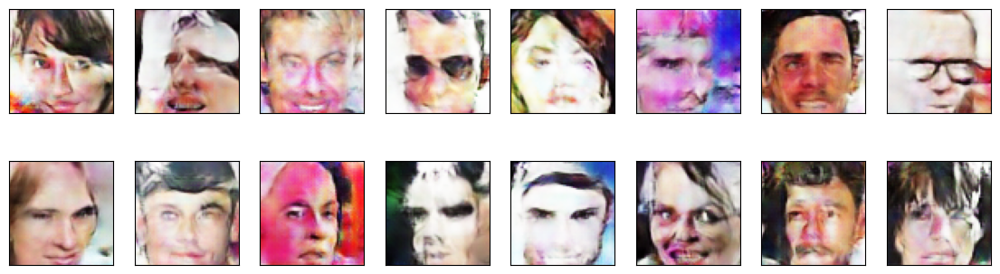

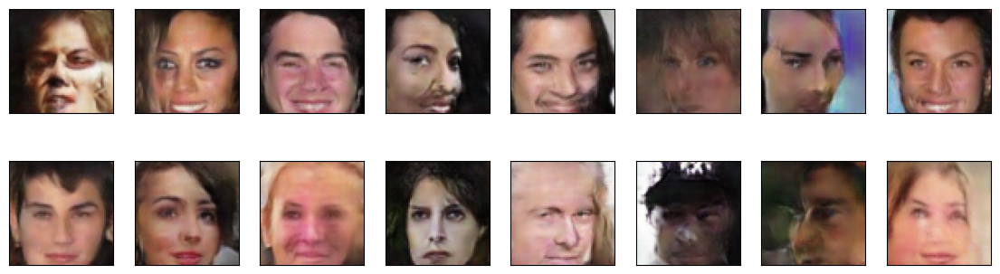

2024-01-24 00:02:24 | Epoch [35/50] | Batch 0/509 | d_loss: 0.5368 | g_loss: 2.9965
2024-01-24 00:02:27 | Epoch [35/50] | Batch 50/509 | d_loss: 0.4710 | g_loss: 2.7990
2024-01-24 00:02:30 | Epoch [35/50] | Batch 100/509 | d_loss: 0.5999 | g_loss: 2.9877
2024-01-24 00:02:33 | Epoch [35/50] | Batch 150/509 | d_loss: 0.4650 | g_loss: 4.0558
2024-01-24 00:02:36 | Epoch [35/50] | Batch 200/509 | d_loss: 0.4945 | g_loss: 2.7943
2024-01-24 00:02:38 | Epoch [35/50] | Batch 250/509 | d_loss: 0.4560 | g_loss: 2.5429
2024-01-24 00:02:41 | Epoch [35/50] | Batch 300/509 | d_loss: 0.7862 | g_loss: 3.3822
2024-01-24 00:02:44 | Epoch [35/50] | Batch 350/509 | d_loss: 0.4958 | g_loss: 3.0158
2024-01-24 00:02:47 | Epoch [35/50] | Batch 400/509 | d_loss: 0.4459 | g_loss: 2.7053
2024-01-24 00:02:50 | Epoch [35/50] | Batch 450/509 | d_loss: 0.4157 | g_loss: 3.7186
2024-01-24 00:02:53 | Epoch [35/50] | Batch 500/509 | d_loss: 0.4798 | g_loss: 3.4158


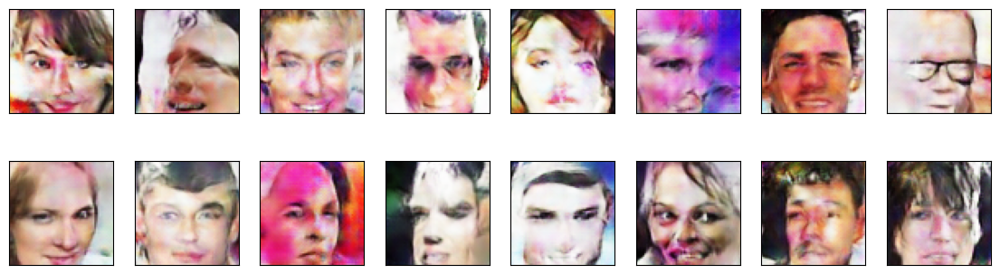

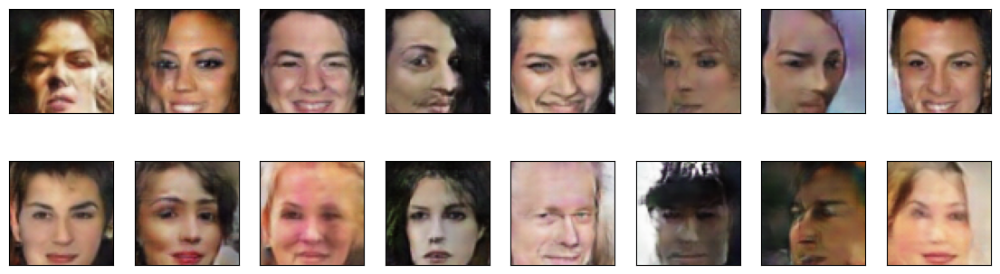

2024-01-24 00:02:55 | Epoch [36/50] | Batch 0/509 | d_loss: 0.5979 | g_loss: 2.1869
2024-01-24 00:02:58 | Epoch [36/50] | Batch 50/509 | d_loss: 0.5012 | g_loss: 2.8133
2024-01-24 00:03:01 | Epoch [36/50] | Batch 100/509 | d_loss: 1.3373 | g_loss: 1.0732
2024-01-24 00:03:04 | Epoch [36/50] | Batch 150/509 | d_loss: 0.4839 | g_loss: 3.3069
2024-01-24 00:03:07 | Epoch [36/50] | Batch 200/509 | d_loss: 0.5566 | g_loss: 2.3017
2024-01-24 00:03:10 | Epoch [36/50] | Batch 250/509 | d_loss: 0.4053 | g_loss: 3.9379
2024-01-24 00:03:12 | Epoch [36/50] | Batch 300/509 | d_loss: 0.4476 | g_loss: 3.6061
2024-01-24 00:03:15 | Epoch [36/50] | Batch 350/509 | d_loss: 0.9203 | g_loss: 4.3099
2024-01-24 00:03:18 | Epoch [36/50] | Batch 400/509 | d_loss: 0.4858 | g_loss: 3.6058
2024-01-24 00:03:21 | Epoch [36/50] | Batch 450/509 | d_loss: 0.4723 | g_loss: 2.7965
2024-01-24 00:03:24 | Epoch [36/50] | Batch 500/509 | d_loss: 0.6453 | g_loss: 2.0306


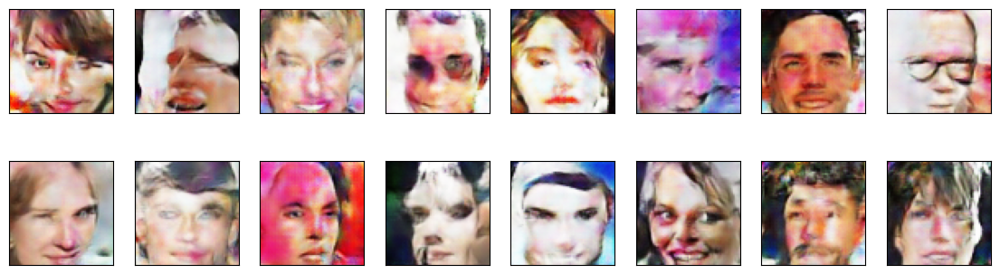

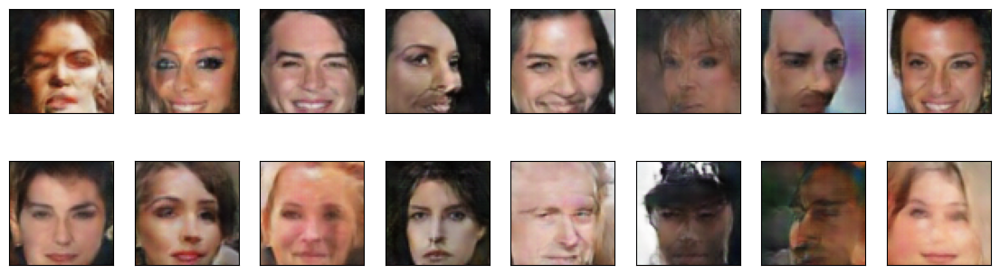

2024-01-24 00:03:26 | Epoch [37/50] | Batch 0/509 | d_loss: 0.4107 | g_loss: 2.9520
2024-01-24 00:03:29 | Epoch [37/50] | Batch 50/509 | d_loss: 0.7811 | g_loss: 2.9079
2024-01-24 00:03:32 | Epoch [37/50] | Batch 100/509 | d_loss: 0.9089 | g_loss: 4.8640
2024-01-24 00:03:35 | Epoch [37/50] | Batch 150/509 | d_loss: 0.6359 | g_loss: 3.5563
2024-01-24 00:03:38 | Epoch [37/50] | Batch 200/509 | d_loss: 0.6359 | g_loss: 2.4091
2024-01-24 00:03:41 | Epoch [37/50] | Batch 250/509 | d_loss: 0.4821 | g_loss: 3.9611
2024-01-24 00:03:44 | Epoch [37/50] | Batch 300/509 | d_loss: 0.4526 | g_loss: 3.6201
2024-01-24 00:03:46 | Epoch [37/50] | Batch 350/509 | d_loss: 1.2101 | g_loss: 1.2914
2024-01-24 00:03:49 | Epoch [37/50] | Batch 400/509 | d_loss: 0.8230 | g_loss: 3.2466
2024-01-24 00:03:52 | Epoch [37/50] | Batch 450/509 | d_loss: 0.5189 | g_loss: 2.9502
2024-01-24 00:03:55 | Epoch [37/50] | Batch 500/509 | d_loss: 0.5767 | g_loss: 3.0417


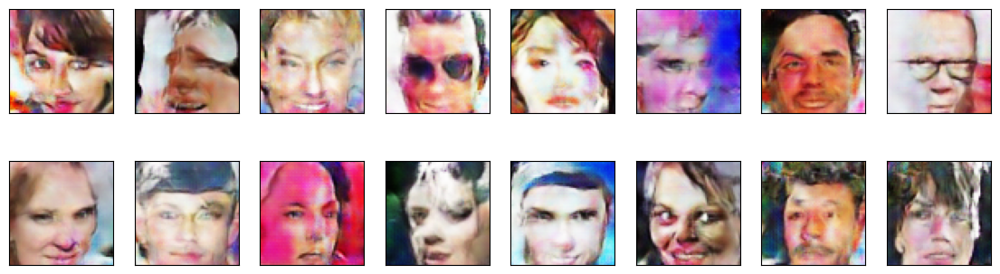

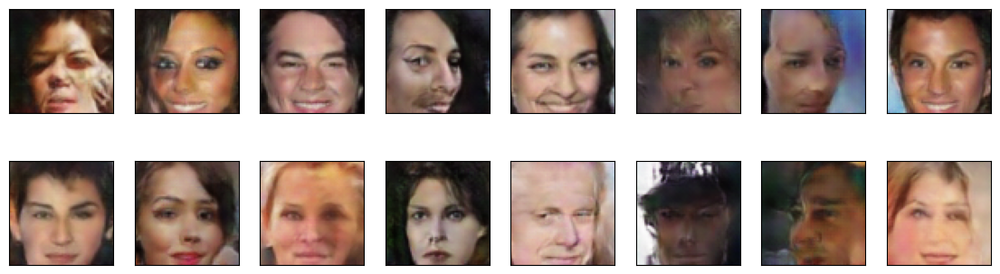

2024-01-24 00:03:57 | Epoch [38/50] | Batch 0/509 | d_loss: 0.4314 | g_loss: 3.3303
2024-01-24 00:04:00 | Epoch [38/50] | Batch 50/509 | d_loss: 0.4678 | g_loss: 3.1365
2024-01-24 00:04:03 | Epoch [38/50] | Batch 100/509 | d_loss: 0.4357 | g_loss: 3.4948
2024-01-24 00:04:06 | Epoch [38/50] | Batch 150/509 | d_loss: 0.4326 | g_loss: 3.3434
2024-01-24 00:04:09 | Epoch [38/50] | Batch 200/509 | d_loss: 0.5556 | g_loss: 3.1941
2024-01-24 00:04:12 | Epoch [38/50] | Batch 250/509 | d_loss: 0.5670 | g_loss: 3.4292
2024-01-24 00:04:15 | Epoch [38/50] | Batch 300/509 | d_loss: 0.6008 | g_loss: 2.6038
2024-01-24 00:04:18 | Epoch [38/50] | Batch 350/509 | d_loss: 0.6172 | g_loss: 4.3289
2024-01-24 00:04:21 | Epoch [38/50] | Batch 400/509 | d_loss: 0.4847 | g_loss: 3.4851
2024-01-24 00:04:23 | Epoch [38/50] | Batch 450/509 | d_loss: 0.4471 | g_loss: 2.8583
2024-01-24 00:04:26 | Epoch [38/50] | Batch 500/509 | d_loss: 0.4662 | g_loss: 3.3204


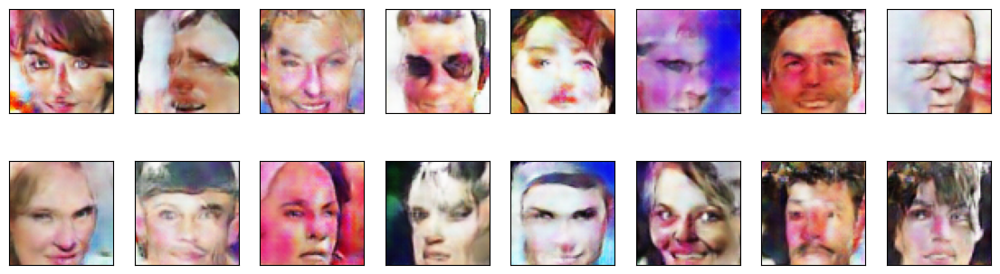

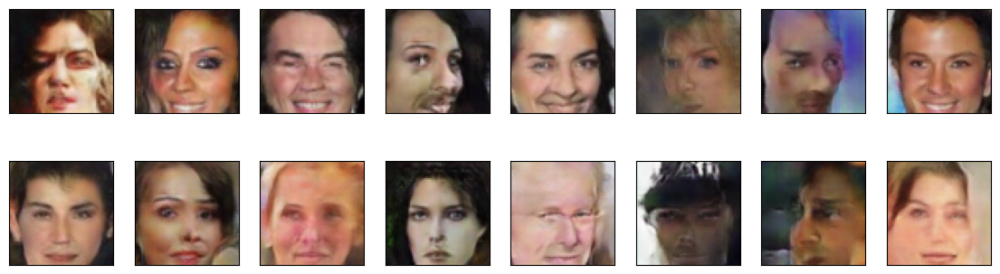

2024-01-24 00:04:28 | Epoch [39/50] | Batch 0/509 | d_loss: 0.4662 | g_loss: 3.8668
2024-01-24 00:04:31 | Epoch [39/50] | Batch 50/509 | d_loss: 0.5906 | g_loss: 4.0272
2024-01-24 00:04:34 | Epoch [39/50] | Batch 100/509 | d_loss: 0.3861 | g_loss: 5.0912
2024-01-24 00:04:37 | Epoch [39/50] | Batch 150/509 | d_loss: 0.8376 | g_loss: 4.1375
2024-01-24 00:04:40 | Epoch [39/50] | Batch 200/509 | d_loss: 0.4227 | g_loss: 2.8006
2024-01-24 00:04:43 | Epoch [39/50] | Batch 250/509 | d_loss: 0.5926 | g_loss: 2.0110
2024-01-24 00:04:46 | Epoch [39/50] | Batch 300/509 | d_loss: 0.4243 | g_loss: 2.8078
2024-01-24 00:04:49 | Epoch [39/50] | Batch 350/509 | d_loss: 0.8839 | g_loss: 4.6903
2024-01-24 00:04:52 | Epoch [39/50] | Batch 400/509 | d_loss: 0.5091 | g_loss: 2.9217
2024-01-24 00:04:54 | Epoch [39/50] | Batch 450/509 | d_loss: 1.0163 | g_loss: 4.5002
2024-01-24 00:04:57 | Epoch [39/50] | Batch 500/509 | d_loss: 0.5414 | g_loss: 3.4896


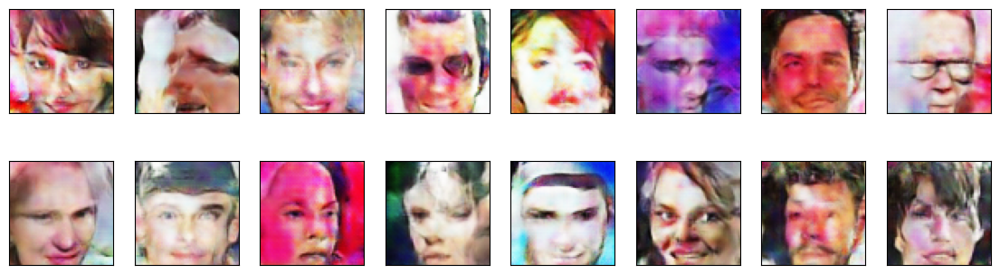

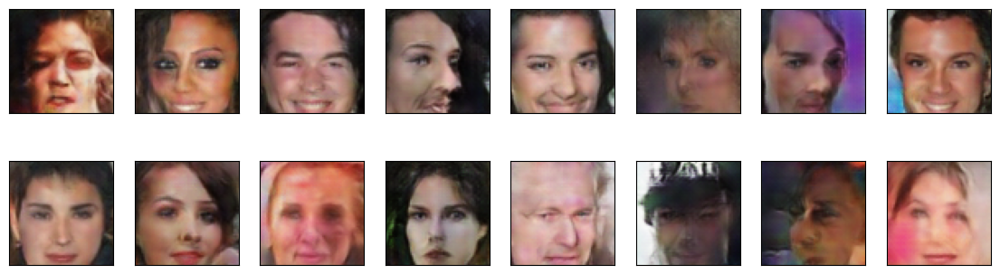

2024-01-24 00:04:59 | Epoch [40/50] | Batch 0/509 | d_loss: 0.4398 | g_loss: 3.4999
2024-01-24 00:05:02 | Epoch [40/50] | Batch 50/509 | d_loss: 0.4133 | g_loss: 3.3230
2024-01-24 00:05:05 | Epoch [40/50] | Batch 100/509 | d_loss: 0.4041 | g_loss: 3.6378
2024-01-24 00:05:08 | Epoch [40/50] | Batch 150/509 | d_loss: 0.9757 | g_loss: 2.6860
2024-01-24 00:05:11 | Epoch [40/50] | Batch 200/509 | d_loss: 0.5665 | g_loss: 2.0071
2024-01-24 00:05:14 | Epoch [40/50] | Batch 250/509 | d_loss: 0.7537 | g_loss: 3.6479
2024-01-24 00:05:17 | Epoch [40/50] | Batch 300/509 | d_loss: 0.4785 | g_loss: 2.1057
2024-01-24 00:05:20 | Epoch [40/50] | Batch 350/509 | d_loss: 0.5668 | g_loss: 3.1834
2024-01-24 00:05:23 | Epoch [40/50] | Batch 400/509 | d_loss: 0.5237 | g_loss: 2.8430
2024-01-24 00:05:26 | Epoch [40/50] | Batch 450/509 | d_loss: 0.4976 | g_loss: 3.2094
2024-01-24 00:05:28 | Epoch [40/50] | Batch 500/509 | d_loss: 0.4497 | g_loss: 3.0851


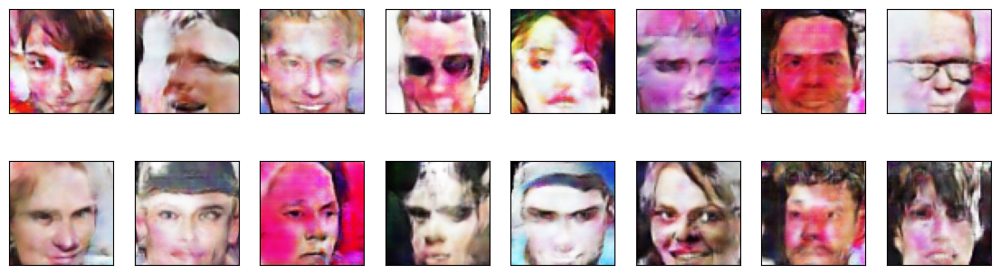

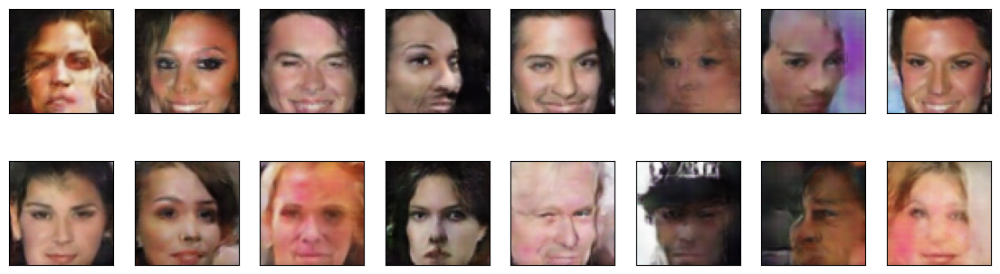

2024-01-24 00:05:30 | Epoch [41/50] | Batch 0/509 | d_loss: 0.4271 | g_loss: 3.2877
2024-01-24 00:05:33 | Epoch [41/50] | Batch 50/509 | d_loss: 0.4360 | g_loss: 3.8974
2024-01-24 00:05:36 | Epoch [41/50] | Batch 100/509 | d_loss: 0.4290 | g_loss: 4.1963
2024-01-24 00:05:39 | Epoch [41/50] | Batch 150/509 | d_loss: 0.4573 | g_loss: 3.9300
2024-01-24 00:05:42 | Epoch [41/50] | Batch 200/509 | d_loss: 0.4466 | g_loss: 3.5481
2024-01-24 00:05:45 | Epoch [41/50] | Batch 250/509 | d_loss: 0.4191 | g_loss: 2.9104
2024-01-24 00:05:48 | Epoch [41/50] | Batch 300/509 | d_loss: 0.7386 | g_loss: 3.2694
2024-01-24 00:05:51 | Epoch [41/50] | Batch 350/509 | d_loss: 0.4377 | g_loss: 3.6115
2024-01-24 00:05:54 | Epoch [41/50] | Batch 400/509 | d_loss: 0.3816 | g_loss: 4.3533
2024-01-24 00:05:57 | Epoch [41/50] | Batch 450/509 | d_loss: 0.4205 | g_loss: 3.5612
2024-01-24 00:06:00 | Epoch [41/50] | Batch 500/509 | d_loss: 0.4612 | g_loss: 3.1355


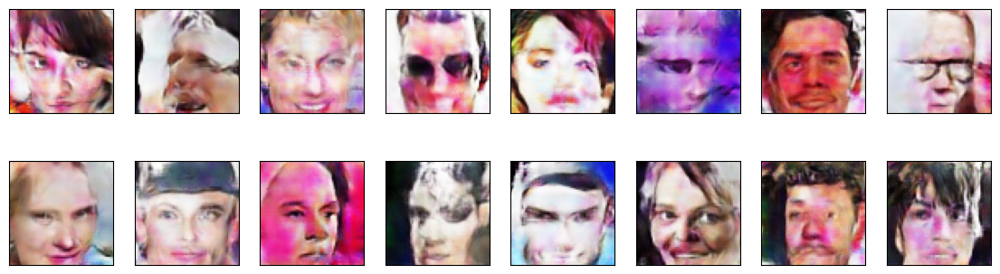

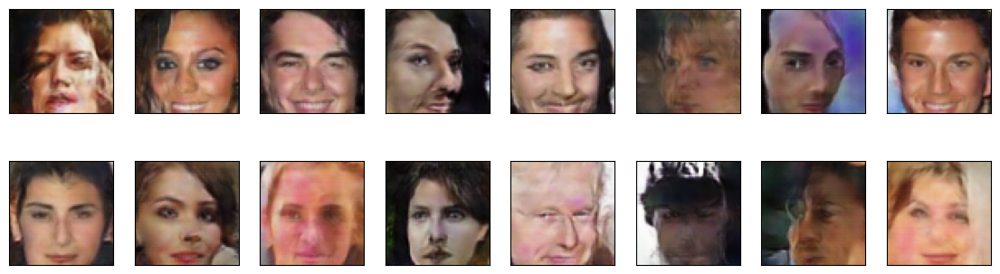

2024-01-24 00:06:02 | Epoch [42/50] | Batch 0/509 | d_loss: 0.4882 | g_loss: 3.4265
2024-01-24 00:06:04 | Epoch [42/50] | Batch 50/509 | d_loss: 0.4103 | g_loss: 3.9680
2024-01-24 00:06:07 | Epoch [42/50] | Batch 100/509 | d_loss: 0.4810 | g_loss: 3.0688
2024-01-24 00:06:10 | Epoch [42/50] | Batch 150/509 | d_loss: 0.8519 | g_loss: 1.2245
2024-01-24 00:06:13 | Epoch [42/50] | Batch 200/509 | d_loss: 0.4352 | g_loss: 3.7473
2024-01-24 00:06:16 | Epoch [42/50] | Batch 250/509 | d_loss: 0.6089 | g_loss: 3.3688
2024-01-24 00:06:19 | Epoch [42/50] | Batch 300/509 | d_loss: 0.6325 | g_loss: 2.3033
2024-01-24 00:06:22 | Epoch [42/50] | Batch 350/509 | d_loss: 0.4535 | g_loss: 2.9143
2024-01-24 00:06:25 | Epoch [42/50] | Batch 400/509 | d_loss: 0.4326 | g_loss: 3.3370
2024-01-24 00:06:28 | Epoch [42/50] | Batch 450/509 | d_loss: 0.5894 | g_loss: 3.5307
2024-01-24 00:06:31 | Epoch [42/50] | Batch 500/509 | d_loss: 0.4210 | g_loss: 3.9563


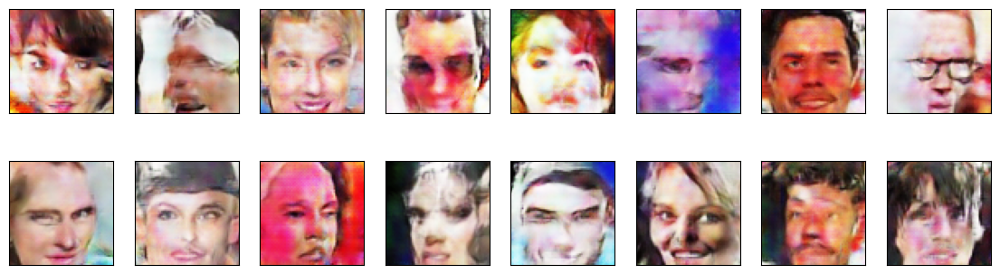

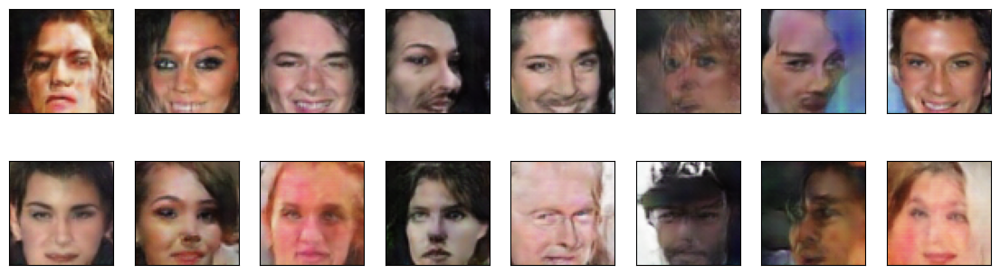

2024-01-24 00:06:33 | Epoch [43/50] | Batch 0/509 | d_loss: 0.4217 | g_loss: 3.2238
2024-01-24 00:06:35 | Epoch [43/50] | Batch 50/509 | d_loss: 0.7702 | g_loss: 1.4906
2024-01-24 00:06:38 | Epoch [43/50] | Batch 100/509 | d_loss: 0.4818 | g_loss: 3.1964
2024-01-24 00:06:41 | Epoch [43/50] | Batch 150/509 | d_loss: 0.4592 | g_loss: 3.0711
2024-01-24 00:06:44 | Epoch [43/50] | Batch 200/509 | d_loss: 0.4047 | g_loss: 3.8755
2024-01-24 00:06:47 | Epoch [43/50] | Batch 250/509 | d_loss: 0.4187 | g_loss: 3.8381
2024-01-24 00:06:50 | Epoch [43/50] | Batch 300/509 | d_loss: 0.7443 | g_loss: 2.2791
2024-01-24 00:06:53 | Epoch [43/50] | Batch 350/509 | d_loss: 0.5733 | g_loss: 2.2924
2024-01-24 00:06:56 | Epoch [43/50] | Batch 400/509 | d_loss: 0.4588 | g_loss: 3.8327
2024-01-24 00:06:59 | Epoch [43/50] | Batch 450/509 | d_loss: 0.4595 | g_loss: 2.8701
2024-01-24 00:07:02 | Epoch [43/50] | Batch 500/509 | d_loss: 0.4892 | g_loss: 4.5863


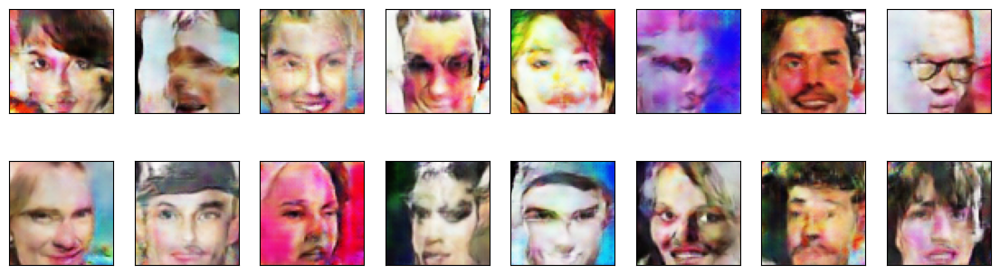

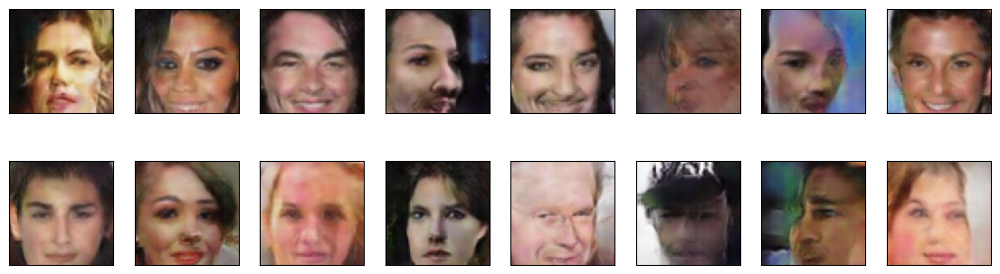

2024-01-24 00:07:04 | Epoch [44/50] | Batch 0/509 | d_loss: 0.5773 | g_loss: 3.3947
2024-01-24 00:07:07 | Epoch [44/50] | Batch 50/509 | d_loss: 0.9268 | g_loss: 3.7318
2024-01-24 00:07:09 | Epoch [44/50] | Batch 100/509 | d_loss: 0.4811 | g_loss: 2.5829
2024-01-24 00:07:12 | Epoch [44/50] | Batch 150/509 | d_loss: 0.4544 | g_loss: 3.7120
2024-01-24 00:07:15 | Epoch [44/50] | Batch 200/509 | d_loss: 0.4183 | g_loss: 3.8087
2024-01-24 00:07:18 | Epoch [44/50] | Batch 250/509 | d_loss: 0.6353 | g_loss: 2.7290
2024-01-24 00:07:21 | Epoch [44/50] | Batch 300/509 | d_loss: 1.0617 | g_loss: 2.5600
2024-01-24 00:07:24 | Epoch [44/50] | Batch 350/509 | d_loss: 0.5214 | g_loss: 2.1551
2024-01-24 00:07:27 | Epoch [44/50] | Batch 400/509 | d_loss: 0.7698 | g_loss: 4.5969
2024-01-24 00:07:30 | Epoch [44/50] | Batch 450/509 | d_loss: 0.4094 | g_loss: 3.6862
2024-01-24 00:07:33 | Epoch [44/50] | Batch 500/509 | d_loss: 0.6776 | g_loss: 3.9341


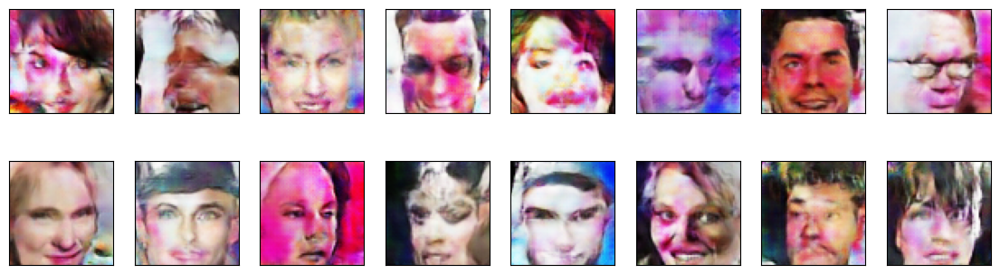

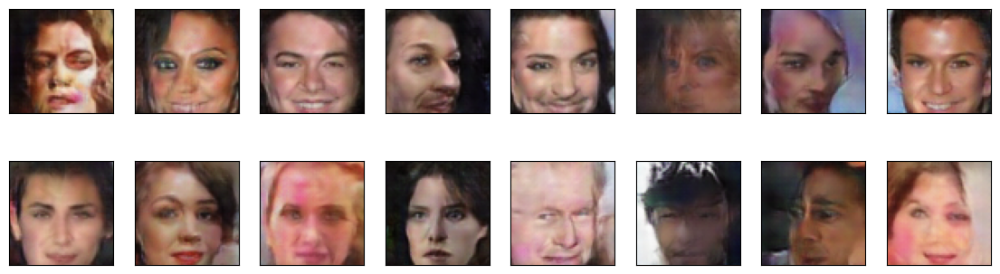

2024-01-24 00:07:35 | Epoch [45/50] | Batch 0/509 | d_loss: 0.4356 | g_loss: 2.8927
2024-01-24 00:07:38 | Epoch [45/50] | Batch 50/509 | d_loss: 0.7378 | g_loss: 1.9295
2024-01-24 00:07:41 | Epoch [45/50] | Batch 100/509 | d_loss: 0.7316 | g_loss: 1.1707
2024-01-24 00:07:43 | Epoch [45/50] | Batch 150/509 | d_loss: 0.6544 | g_loss: 2.5045
2024-01-24 00:07:46 | Epoch [45/50] | Batch 200/509 | d_loss: 0.4074 | g_loss: 4.2463
2024-01-24 00:07:49 | Epoch [45/50] | Batch 250/509 | d_loss: 0.4434 | g_loss: 4.0216
2024-01-24 00:07:52 | Epoch [45/50] | Batch 300/509 | d_loss: 0.5038 | g_loss: 2.5260
2024-01-24 00:07:55 | Epoch [45/50] | Batch 350/509 | d_loss: 0.8297 | g_loss: 1.3640
2024-01-24 00:07:58 | Epoch [45/50] | Batch 400/509 | d_loss: 0.6040 | g_loss: 3.9867
2024-01-24 00:08:01 | Epoch [45/50] | Batch 450/509 | d_loss: 0.4679 | g_loss: 3.2056
2024-01-24 00:08:04 | Epoch [45/50] | Batch 500/509 | d_loss: 0.4785 | g_loss: 3.5126


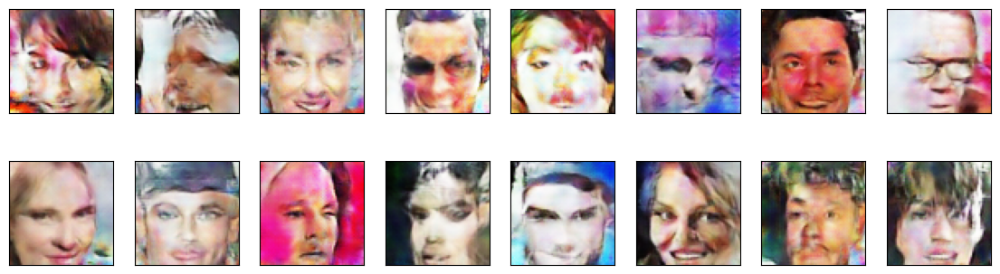

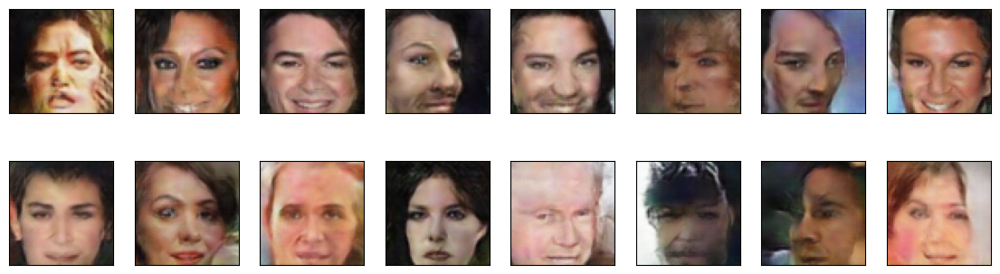

2024-01-24 00:08:06 | Epoch [46/50] | Batch 0/509 | d_loss: 0.8698 | g_loss: 3.1287
2024-01-24 00:08:09 | Epoch [46/50] | Batch 50/509 | d_loss: 0.4530 | g_loss: 3.3852
2024-01-24 00:08:12 | Epoch [46/50] | Batch 100/509 | d_loss: 0.6066 | g_loss: 2.5803
2024-01-24 00:08:15 | Epoch [46/50] | Batch 150/509 | d_loss: 0.9622 | g_loss: 3.8985
2024-01-24 00:08:18 | Epoch [46/50] | Batch 200/509 | d_loss: 0.4149 | g_loss: 3.1390
2024-01-24 00:08:20 | Epoch [46/50] | Batch 250/509 | d_loss: 0.4291 | g_loss: 2.8230
2024-01-24 00:08:23 | Epoch [46/50] | Batch 300/509 | d_loss: 0.4137 | g_loss: 3.7937
2024-01-24 00:08:26 | Epoch [46/50] | Batch 350/509 | d_loss: 0.4644 | g_loss: 2.7891
2024-01-24 00:08:29 | Epoch [46/50] | Batch 400/509 | d_loss: 0.5528 | g_loss: 2.1701
2024-01-24 00:08:32 | Epoch [46/50] | Batch 450/509 | d_loss: 0.5375 | g_loss: 2.9600
2024-01-24 00:08:35 | Epoch [46/50] | Batch 500/509 | d_loss: 0.4276 | g_loss: 3.2914


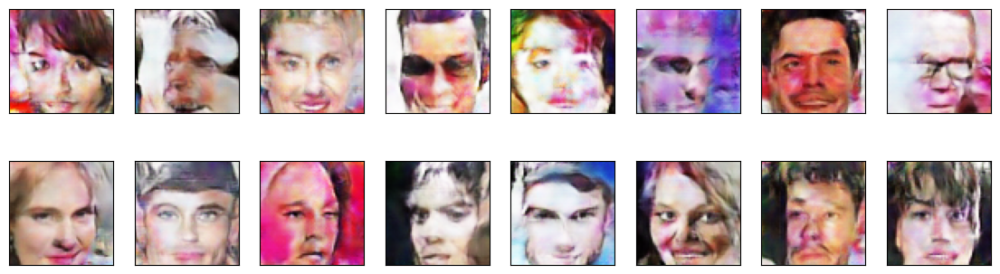

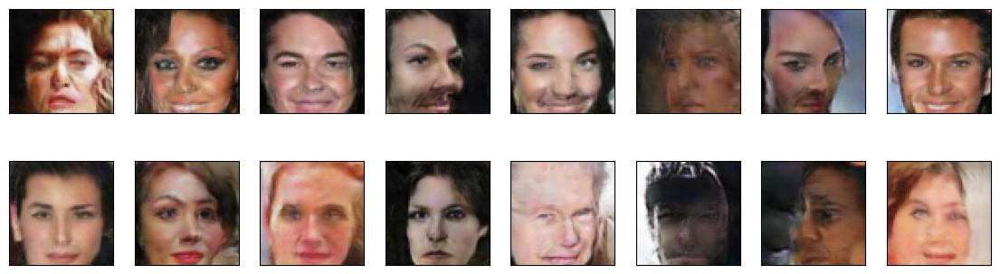

2024-01-24 00:08:37 | Epoch [47/50] | Batch 0/509 | d_loss: 0.5212 | g_loss: 2.7678
2024-01-24 00:08:40 | Epoch [47/50] | Batch 50/509 | d_loss: 0.4055 | g_loss: 3.8579
2024-01-24 00:08:43 | Epoch [47/50] | Batch 100/509 | d_loss: 0.4164 | g_loss: 3.7032
2024-01-24 00:08:46 | Epoch [47/50] | Batch 150/509 | d_loss: 1.1943 | g_loss: 5.9561
2024-01-24 00:08:49 | Epoch [47/50] | Batch 200/509 | d_loss: 0.5018 | g_loss: 3.8476
2024-01-24 00:08:52 | Epoch [47/50] | Batch 250/509 | d_loss: 0.4471 | g_loss: 4.0759
2024-01-24 00:08:55 | Epoch [47/50] | Batch 300/509 | d_loss: 1.0859 | g_loss: 1.4520
2024-01-24 00:08:57 | Epoch [47/50] | Batch 350/509 | d_loss: 0.5500 | g_loss: 2.2728
2024-01-24 00:09:00 | Epoch [47/50] | Batch 400/509 | d_loss: 0.4156 | g_loss: 3.7178
2024-01-24 00:09:03 | Epoch [47/50] | Batch 450/509 | d_loss: 0.5054 | g_loss: 4.3243
2024-01-24 00:09:06 | Epoch [47/50] | Batch 500/509 | d_loss: 0.8527 | g_loss: 2.7975


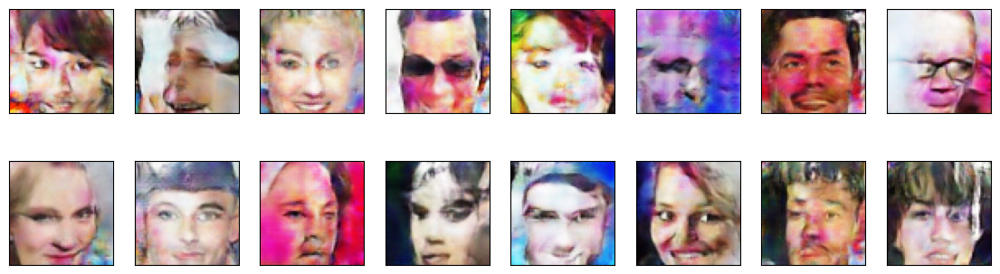

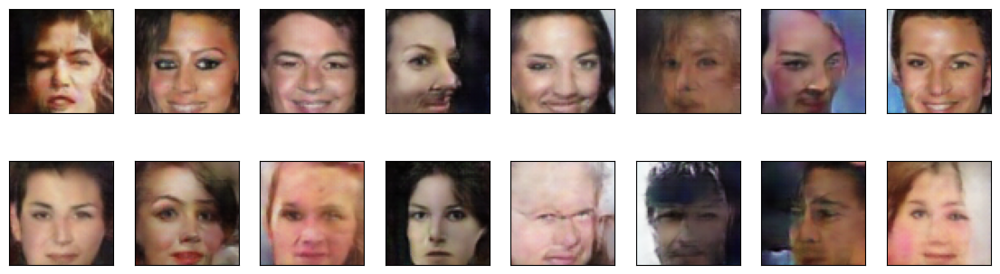

2024-01-24 00:09:08 | Epoch [48/50] | Batch 0/509 | d_loss: 0.6837 | g_loss: 2.7626
2024-01-24 00:09:11 | Epoch [48/50] | Batch 50/509 | d_loss: 0.4509 | g_loss: 3.2815
2024-01-24 00:09:14 | Epoch [48/50] | Batch 100/509 | d_loss: 0.5063 | g_loss: 2.6321
2024-01-24 00:09:17 | Epoch [48/50] | Batch 150/509 | d_loss: 0.4829 | g_loss: 3.1582
2024-01-24 00:09:20 | Epoch [48/50] | Batch 200/509 | d_loss: 0.4941 | g_loss: 3.1197
2024-01-24 00:09:23 | Epoch [48/50] | Batch 250/509 | d_loss: 0.6476 | g_loss: 3.9868
2024-01-24 00:09:26 | Epoch [48/50] | Batch 300/509 | d_loss: 0.5681 | g_loss: 3.3570
2024-01-24 00:09:28 | Epoch [48/50] | Batch 350/509 | d_loss: 0.5415 | g_loss: 2.6948
2024-01-24 00:09:31 | Epoch [48/50] | Batch 400/509 | d_loss: 0.6295 | g_loss: 2.6526
2024-01-24 00:09:34 | Epoch [48/50] | Batch 450/509 | d_loss: 0.8557 | g_loss: 0.7359
2024-01-24 00:09:37 | Epoch [48/50] | Batch 500/509 | d_loss: 0.4974 | g_loss: 2.8077


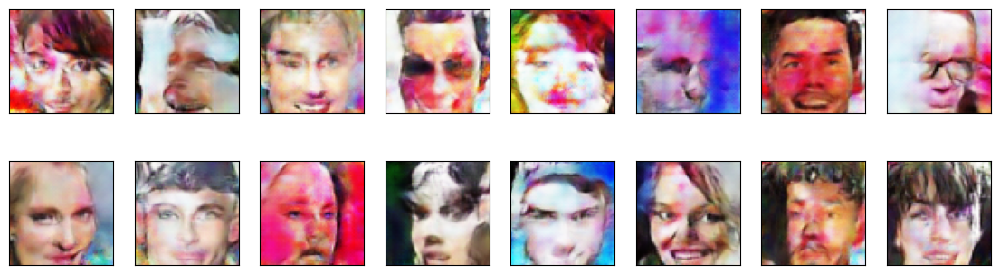

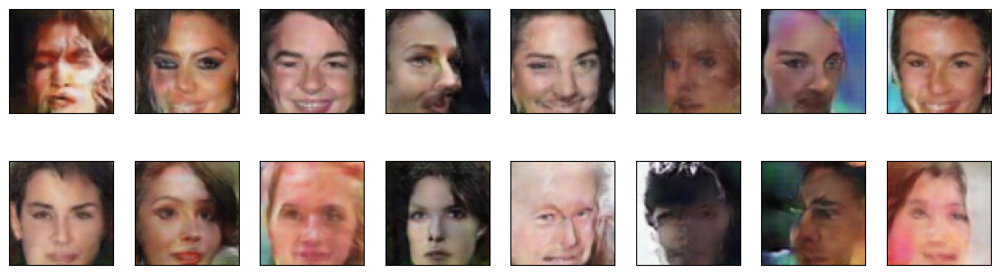

2024-01-24 00:09:39 | Epoch [49/50] | Batch 0/509 | d_loss: 0.4402 | g_loss: 3.2747
2024-01-24 00:09:42 | Epoch [49/50] | Batch 50/509 | d_loss: 0.3971 | g_loss: 4.6281
2024-01-24 00:09:45 | Epoch [49/50] | Batch 100/509 | d_loss: 0.6149 | g_loss: 4.5933
2024-01-24 00:09:48 | Epoch [49/50] | Batch 150/509 | d_loss: 0.4785 | g_loss: 3.6377
2024-01-24 00:09:51 | Epoch [49/50] | Batch 200/509 | d_loss: 0.7885 | g_loss: 3.0529
2024-01-24 00:09:54 | Epoch [49/50] | Batch 250/509 | d_loss: 0.4232 | g_loss: 3.7261
2024-01-24 00:09:57 | Epoch [49/50] | Batch 300/509 | d_loss: 1.1262 | g_loss: 0.8537
2024-01-24 00:10:00 | Epoch [49/50] | Batch 350/509 | d_loss: 0.5202 | g_loss: 2.9784
2024-01-24 00:10:02 | Epoch [49/50] | Batch 400/509 | d_loss: 0.5685 | g_loss: 1.9054
2024-01-24 00:10:05 | Epoch [49/50] | Batch 450/509 | d_loss: 0.5296 | g_loss: 2.5558
2024-01-24 00:10:08 | Epoch [49/50] | Batch 500/509 | d_loss: 0.4328 | g_loss: 3.8349


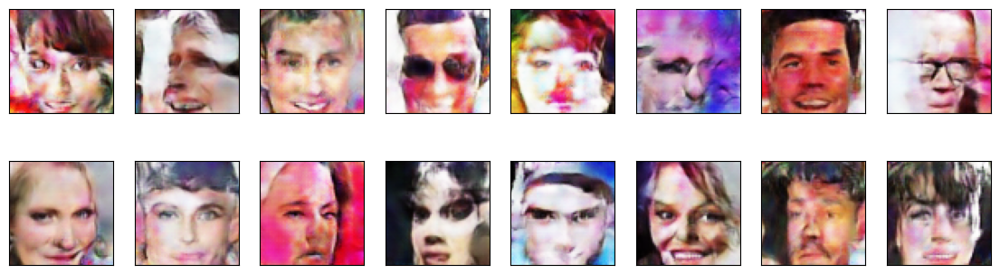

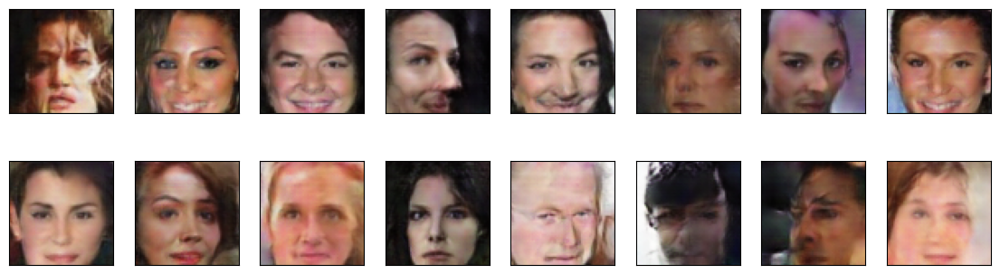

2024-01-24 00:10:10 | Epoch [50/50] | Batch 0/509 | d_loss: 0.4606 | g_loss: 3.3698
2024-01-24 00:10:13 | Epoch [50/50] | Batch 50/509 | d_loss: 0.4194 | g_loss: 3.7602
2024-01-24 00:10:16 | Epoch [50/50] | Batch 100/509 | d_loss: 0.4868 | g_loss: 2.9610
2024-01-24 00:10:19 | Epoch [50/50] | Batch 150/509 | d_loss: 0.4051 | g_loss: 2.8582
2024-01-24 00:10:22 | Epoch [50/50] | Batch 200/509 | d_loss: 0.3833 | g_loss: 4.6170
2024-01-24 00:10:25 | Epoch [50/50] | Batch 250/509 | d_loss: 0.6498 | g_loss: 2.3807
2024-01-24 00:10:28 | Epoch [50/50] | Batch 300/509 | d_loss: 0.4101 | g_loss: 3.7802
2024-01-24 00:10:31 | Epoch [50/50] | Batch 350/509 | d_loss: 0.4401 | g_loss: 4.3778
2024-01-24 00:10:34 | Epoch [50/50] | Batch 400/509 | d_loss: 0.4990 | g_loss: 3.5286
2024-01-24 00:10:36 | Epoch [50/50] | Batch 450/509 | d_loss: 0.4206 | g_loss: 3.5949
2024-01-24 00:10:39 | Epoch [50/50] | Batch 500/509 | d_loss: 0.6084 | g_loss: 4.1210


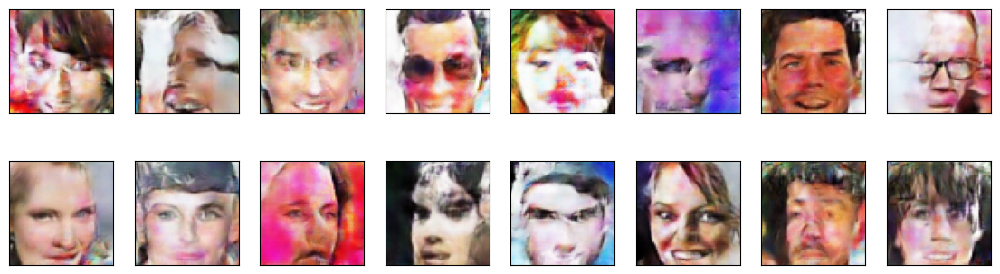

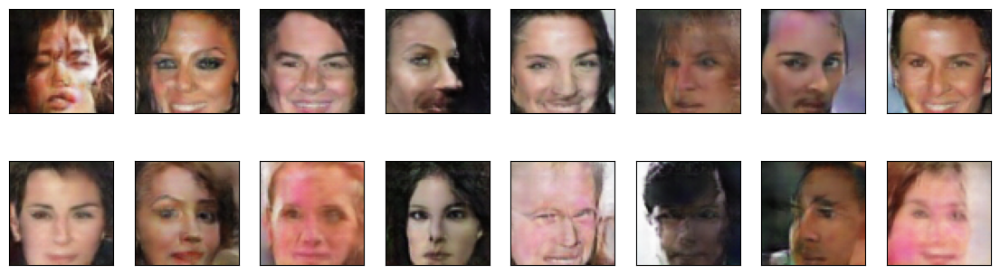

In [63]:
fixed_latent_vector = torch.randn(16, latent_dim, 1, 1).float().cuda()
fixed_latent_vector = fixed_latent_vector.to(device)

fixed_latent_vector_uniform = np.random.uniform(-1, 1, size=(16, latent_dim))
fixed_latent_vector_uniform = torch.from_numpy(fixed_latent_vector_uniform).float()[:,:,None,None]    
fixed_latent_vector_uniform = fixed_latent_vector_uniform.to(device)

losses = []
for epoch in range(n_epochs):
    for batch_i, real_images in enumerate(dataloader):
        real_images = real_images.to(device)            
                
        # TRAIN THE DISCRIMINATOR        
        d_loss = discriminator_step(batch_size, latent_dim, real_images)
        
        
        # TRAIN THE GENERATOR        
        g_loss = generator_step(batch_size, latent_dim)

        ####################################
        
        if batch_i % print_every == 0:
            # append discriminator loss and generator loss
            d = d_loss['loss'].item()
            g = g_loss['loss'].item()
            losses.append((d, g))
            # print discriminator and generator loss
            time = str(datetime.now()).split('.')[0]
            print(f'{time} | Epoch [{epoch+1}/{n_epochs}] | Batch {batch_i}/{len(dataloader)} | d_loss: {d:.4f} | g_loss: {g:.4f}')
    
    # display images during training
    generator.eval()
    generated_images = generator(fixed_latent_vector)
    display(generated_images)
    generated_images = generator(fixed_latent_vector_uniform)
    display(generated_images)
    generator.train()

### Training losses

Plot the training losses for the generator and discriminator.

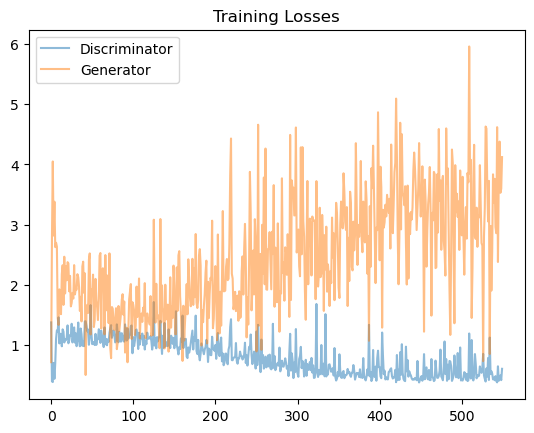

In [64]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

### Question: What do you notice about your generated samples and how might you improve this model?
When you answer this question, consider the following factors:
* The dataset is biased; it is made of "celebrity" faces that are mostly white
* Model size; larger models have the opportunity to learn more features in a data feature space
* Optimization strategy; optimizers and number of epochs affect your final result
* Loss functions

**Answer:** (Write your answer in this cell)

About the dataset, perhaps there is bias, although the 20 samples in the beginning of the notebook does have an interesting coverage at least accross genders. Races not so much. 
Nevertheless, I believe a bigger dataset could give better results.

In terms of experiments, I started with architecture and hyperparameters something based on DCGAN paper, to avoid some of the GAN training instability that's usually mentioned on related documentation and on the course material.

The GAN is trained using latent vectors generated from an uniform distribution between (-1, 1) and I noticed that the model performs worse on generating images for latent vectors from a gaussian/normal distribution. Besides the original 'fixed_latent_vector', I also introduced an 'fixed_latent_vector_uniform' variable, to compare the results over training epochs.

Introducing weight initialization reduced the observed max generated loss

Next steps would be replacing DCGAN architecture to a more modern architecture and eventually introducing gradient penalty if switching Binary Cross Entropy with a different loss function

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb".  

Submit the notebook using the ***SUBMIT*** button in the bottom right corner of the Project Workspace.